<a href="https://colab.research.google.com/github/prasadmaharana/MRI_GAN/blob/main/Capstone_Project_Style_Transfer_Using_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Problem Statement**

**Project By : Prasad Maharana**

Misdiagnosis in the medical field is a very serious issue but it’s also uncomfortably common to occur. Imaging procedures in the medical field requires an expert radiologist’s opinion since interpreting them is not a simple binary process ( Normal or Abnormal). Even so, one radiologist may see something that another does not. This can lead to conflicting reports and make it difficult to effectively recommend treatment options to the patient.

One of the complicated tasks in medical imaging is to diagnose MRI(Magnetic Resonance Imaging). Sometimes to interpret the scan, the radiologist needs different variations of the imaging which can drastically enhance the accuracy of diagnosis by providing practitioners with a more comprehensive understanding.

 

 

But to have access to different imaging is difficult and expensive. With the help of deep learning, we can use style transfer to generate artificial MRI images of different contrast levels from existing MRI scans. This will help to provide a better diagnosis with the help of an additional image.

 

In this capstone, we will use CycleGAN to translate the style of one MRI image to another, which will help in a better understanding of the scanned image. Using GANs we will create T2 weighted images from T1 weighted MRI image and vice-versa.

 

**Problem statement**: To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.

##Pipeline

* Importing Libraries
* Data loading and Visualization
* Data Pre-processing
* Model Building
* Model Training
* Generate a GIF of Generated Images

#Importing Libraries

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
import imageio
from IPython import display
from skimage.transform import resize
from keras.utils.vis_utils import plot_model
from PIL import Image
import pathlib
import glob

In [ ]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.6
session = InteractiveSession(config=config)

#Load the MRI dataset

Note to ensure the dataset is easy to pull, the downloaded dataset has directory hierarchy has been changed such that

* MRI is the root folder
* TrainT1 and TrainT2 folders reside inside MR1 folder

In [ ]:
path="C:/Users/Prasad_Maharana/MRI"
os.chdir(path)  #set root path for dataset

data_dir_tr1 = pathlib.Path("TrainT1/")  #set path for TR1 images
data_dir_tr2 = pathlib.Path("TrainT2/")  #set path for TR2 images


In [ ]:
#load the TR1 images
tr1 = []
for image_path in glob.glob(str(data_dir_tr1)+"\*.png"):
    im = imageio.imread(image_path)
    tr1.append(np.array(im))

tr1=np.array(tr1) #convert list to array
print("Images in TR1: ",len(tr1))

#load the TR1 images
tr2 = []
for image_path in glob.glob(str(data_dir_tr2)+"\*.png"):
    im = imageio.imread(image_path)
    tr2.append(np.array(im))
    
tr2=np.array(tr2)   #convert list to array
print("Images in TR2: ",len(tr2))

Images in TR1:  43
Images in TR2:  46


In [ ]:
#image size of tr1 and tr2
print("Shape of TR1 image: ",tr1[0].shape)
print("Shape of TR2 image: ",tr2[0].shape)


Shape of TR1 image:  (217, 181)
Shape of TR2 image:  (217, 181)


# Normalize the images

Pixel Normalization with Zero Centre

Dividing raw pixel values of range (0, 255) by 127.5 will make it in the range (0, 2) and when we subtract 1 from all the values, we get (-1, 1).

In [ ]:
#normalizing tr1 images
tr1=(tr1/127.5)-1.0  

#normalizing tr2 images
tr2=(tr2/127.5)-1.0  

#Visualize a sample image

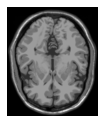

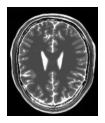

In [ ]:
#visualize a tr1 image
plt.figure(figsize=(2,2))
plt.imshow(tr1[0],cmap='gray')
plt.axis('off')
plt.show()

#visualize a tr1 image
plt.figure(figsize=(2,2))
plt.imshow(tr2[0],cmap='gray')
plt.axis('off')
plt.show()



###**CAUTION:**
**Note: The GPU used to train this Cycle GAN has limited memory which causes an OOM error on an image size of 256 x 256 even after reducing the batch size to 8. Hence it has been resized to 128 x 128 to facilitate the training of the GAN without reaching the memory limit of the GPU.**

#Resize Images

In [ ]:
tr1_data=np.zeros((tr1.shape[0],128,128))
tr2_data=np.zeros((tr2.shape[0],128,128))

for index,img in enumerate(tr1):
  tr1_data[index, :, :]=resize(img,(128,128))

for index,img in enumerate(tr2):
  tr2_data[index, :, :]=resize(img,(128,128))
  
print('Shape of image 4 is {}'.format(tr1_data.shape))
print('Shape of image 9 is {}'.format(tr2_data.shape))

Shape of image 4 is (43, 128, 128)
Shape of image 9 is (46, 128, 128)


#Reshape to add the channel dimension

Reshape images to (32,32,1) with float pixel values

In [ ]:
tr1_data=tr1_data.reshape(tr1_data.shape[0],128,128,1).astype('float32')
tr2_data=tr2_data.reshape(tr2_data.shape[0],128,128,1).astype('float32')

#Shuffle data and store in batches

shuffle- randomly shuffle images of the dataset

batch- combines consecutive images of the dataset into batches 

In [ ]:
BATCH_SIZE=32

In [ ]:
#batch and shuffle data
tr1_data=tf.data.Dataset.from_tensor_slices(tr1_data).shuffle(tr1.shape[0],seed=42).batch(BATCH_SIZE)
tr2_data=tf.data.Dataset.from_tensor_slices(tr2_data).shuffle(tr2.shape[0],seed=42).batch(BATCH_SIZE)

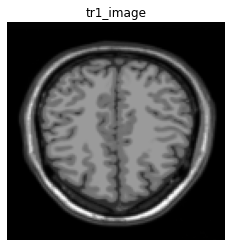

In [ ]:
#plot an tr1 image sample

sample_tr1 = next(iter(tr1_data))
plt.figure(figsize=(4, 4))
plt.imshow(sample_tr1[0].numpy()[:, :, 0], cmap='gray')
plt.title('tr1_image')
plt.axis('off')
plt.show()

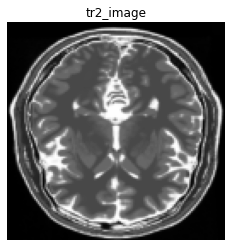

In [ ]:
#plot an tr2 image sample

sample_tr2 = next(iter(tr2_data))
plt.figure(figsize=(4, 4))
plt.imshow(sample_tr2[0].numpy()[:, :, 0], cmap='gray')
plt.title('tr2_image')
plt.axis('off')
plt.show()

##Model Building

1. Instance normalization
2. Down Sampling, Up sampling and U net
3. Generator Building using U net
4. Discriminator Building

####**Instance Normalization**
Instance Normalization are specially used with Style Transfer, where Separate Normalization is performed for each sample we perform channelwise Normalization.

In [ ]:
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

#### Downsampling
Downsampling is performed using the Convolution, leading to reduce in dimensions.

In [ ]:
def downsampling(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result

#### Upsampling
Upsampling is a result of Transposed Convolution, where dimension of image are increased.

In [ ]:
def upsampling(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

#### Unets
Unets takes Image as an input and translate it into another Image. <p>
To do this they first use Downsampling on Input Image to learn the latent characteristics of Input Image and then use Upsampling to use this knowledge to Translate it into another Image. <p>

In [ ]:
# Unet Generator is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
    down_stack = [
        downsampling(64, 4, False), 
        downsampling(128, 4), 
        downsampling(128, 4), 
        downsampling(128, 4), 
        downsampling(128, 4) 
    ]
    up_stack = [
        upsampling(128, 4, True), 
        upsampling(128, 4, True), 
        upsampling(128, 4), 
        upsampling(64, 4) 
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') 
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [ ]:
generator_g = unet_generator()
generator_f = unet_generator()

Let's also visualize one of our Generator Models since Both our Generators have same architecture.

In [ ]:
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 64, 64, 64)   1024        ['input_1[0][0]']                
                                                                                                  
 sequential_1 (Sequential)      (None, 32, 32, 128)  131328      ['sequential[0][0]']             
                                                                                                  
 sequential_2 (Sequential)      (None, 16, 16, 128)  262400      ['sequential_1[0][0]']       

### Discriminator
Discriminator is a traditional CNN, which we use to classify the Images. It only uses Downsampling hence.

Both Discriminators have same architecture

In [ ]:
# Discriminators only contain Convolutional Layers and no Transposed Convolution is not used 
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # add input layer of size (128, 128, 1)
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
    x = inp
    
    # add downsampling step here
    down1 = downsampling(64, 4, False)(x) 
    down2 = downsampling(128, 4)(down1) 
    # add a padding layer here
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2) 
    
    # implement a concrete downsampling layer here
    conv = tf.keras.layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) 
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    
    # apply zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) 
    
    # add a last pure 2D Convolution layer
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)
    return tf.keras.Model(inputs=inp, outputs=last)

In [ ]:
discriminator_x = discriminator()
discriminator_y = discriminator()

In [ ]:
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 128, 128, 1)]     0         
                                                                 
 sequential_18 (Sequential)  (None, 64, 64, 64)        1024      
                                                                 
 sequential_19 (Sequential)  (None, 32, 32, 128)       131328    
                                                                 
 zero_padding2d (ZeroPadding  (None, 34, 34, 128)      0         
 2D)                                                             
                                                                 
 conv2d_12 (Conv2D)          (None, 31, 31, 256)       524288    
                                                                 
 instance_normalization_17 (  (None, 31, 31, 256)      512       
 InstanceNormalization)                                    

## Model Training
1. Declare Loss type
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

Check output of Untrained Generator models which should be a random noise

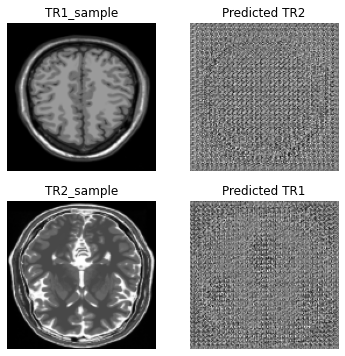

In [ ]:
to_tr2_data = generator_g(sample_tr1)
to_tr1_data = generator_f(sample_tr2)
plt.figure(figsize=(6, 6))

imgs = [sample_tr1, to_tr2_data, sample_tr2, to_tr1_data]
title = ['TR1_sample', 'Predicted TR2', 'TR2_sample', 'Predicted TR1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

#### Declare Loss as Binary Cross Entropy
Since Our Discriminator is a classifier

In [ ]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss
It consists of two types of losses
1.    Loss on Real Data
2.    Loss on Fake Data

In [ ]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses

#### Generator Loss
It has only one type of loss - Discriminator Loss on Generated data

In [ ]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

#### Cycle Loss
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

In [ ]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return 10.0 * loss1

#### Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.

In [ ]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return 0.5*loss

#### Optimizer 
We use Adam Optimizer to update weights which is a good optimizer to achieve quick learning.

In [ ]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
EPOCHS = 200

In [ ]:
checkpoint_path = "./TrainedCGAN_Model"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

Function to show Images output by Generators while Training

In [ ]:
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(12, 8))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input Image', 'Predicted Image', 'Input Image', 'Predicted Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### Training FLow
Below Function performs one Flow of Batch Training <p>
Notice that Identity Loss and Cycle Loss are only used in training Generator and not Discriminator

Sequence of Training Flow


1.   Generate Fake Y and Cycled X
2.   Generate Fake X and Cycled Y
3.   Generate Fake Images through G and F for Identity Loss.
4.   Calculate Discriminator Loss for Disc X and Disc Y on Fake Data for Generator Training.
5.   Calculate Generator Loss on Discriminator.
6.   Calculate Cycled Loss on Cycled Images from step 1 and 2.
7.   Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8.   Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9.   Calculate the Gradients and update the weight and bias of models.



In [ ]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)
        
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)
        
        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)
        
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        # Discriminator's loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

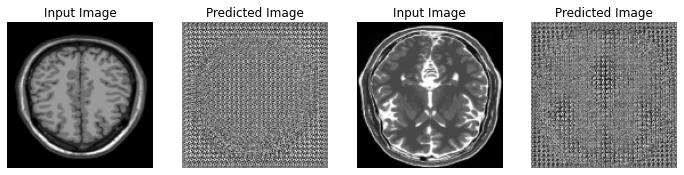

Saving checkpoint for epoch 1 at ./TrainedCGAN_Model\ckpt-1


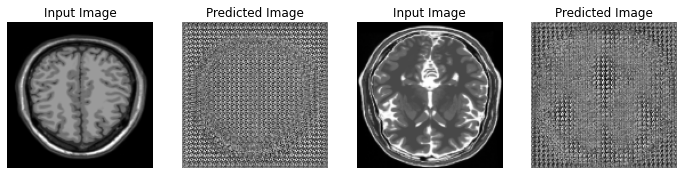

Saving checkpoint for epoch 2 at ./TrainedCGAN_Model\ckpt-2


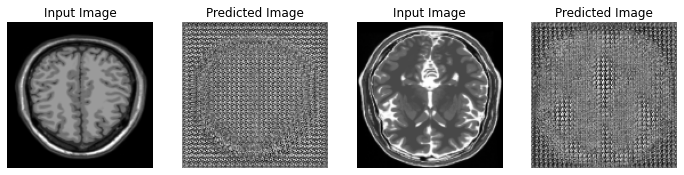

Saving checkpoint for epoch 3 at ./TrainedCGAN_Model\ckpt-3


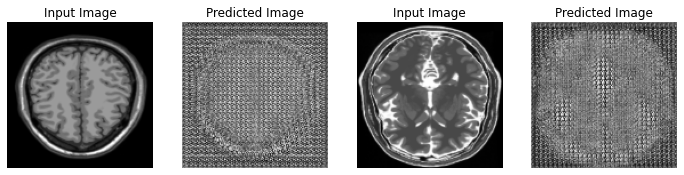

Saving checkpoint for epoch 4 at ./TrainedCGAN_Model\ckpt-4


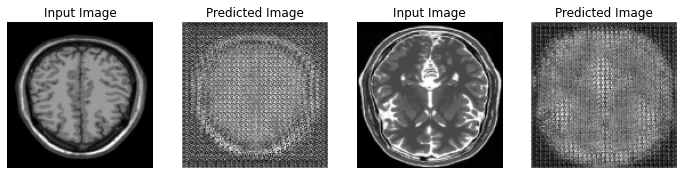

Saving checkpoint for epoch 5 at ./TrainedCGAN_Model\ckpt-5


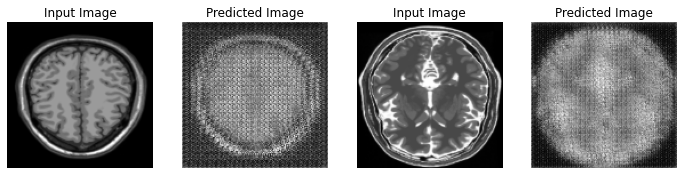

Saving checkpoint for epoch 6 at ./TrainedCGAN_Model\ckpt-6


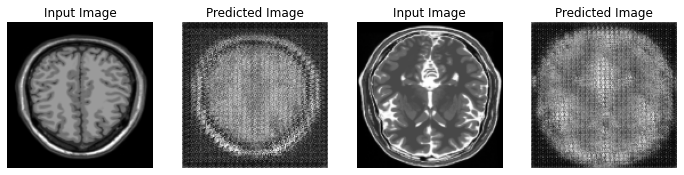

Saving checkpoint for epoch 7 at ./TrainedCGAN_Model\ckpt-7


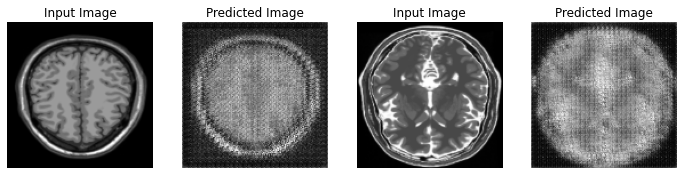

Saving checkpoint for epoch 8 at ./TrainedCGAN_Model\ckpt-8


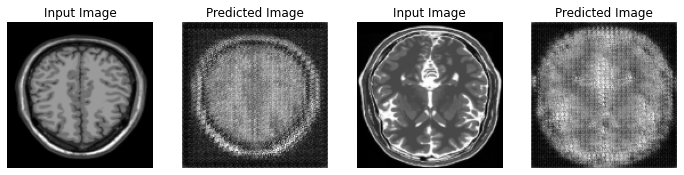

Saving checkpoint for epoch 9 at ./TrainedCGAN_Model\ckpt-9


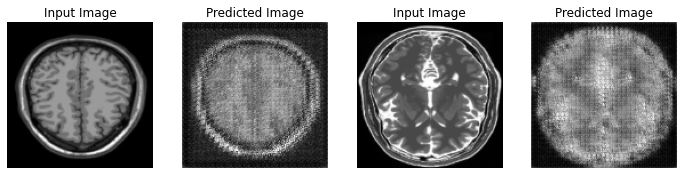

Saving checkpoint for epoch 10 at ./TrainedCGAN_Model\ckpt-10


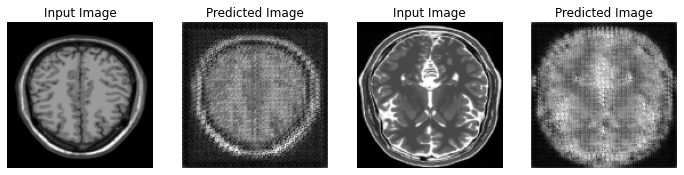

Saving checkpoint for epoch 11 at ./TrainedCGAN_Model\ckpt-11


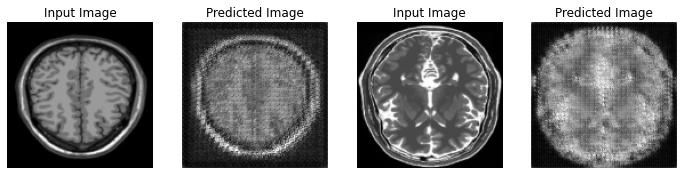

Saving checkpoint for epoch 12 at ./TrainedCGAN_Model\ckpt-12


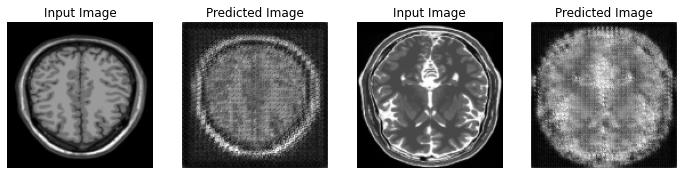

Saving checkpoint for epoch 13 at ./TrainedCGAN_Model\ckpt-13


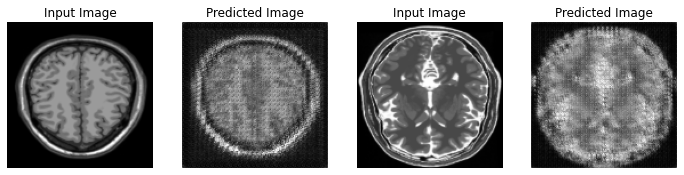

Saving checkpoint for epoch 14 at ./TrainedCGAN_Model\ckpt-14


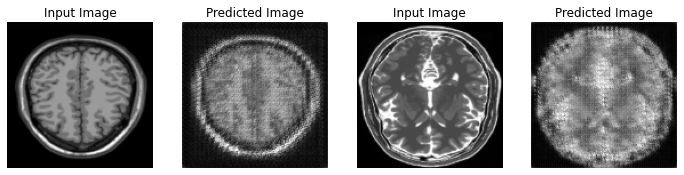

Saving checkpoint for epoch 15 at ./TrainedCGAN_Model\ckpt-15


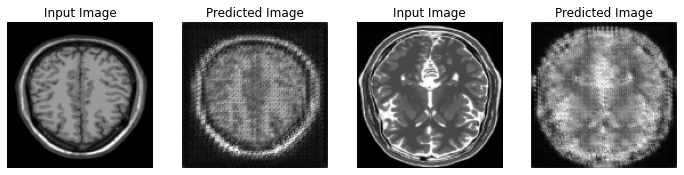

Saving checkpoint for epoch 16 at ./TrainedCGAN_Model\ckpt-16


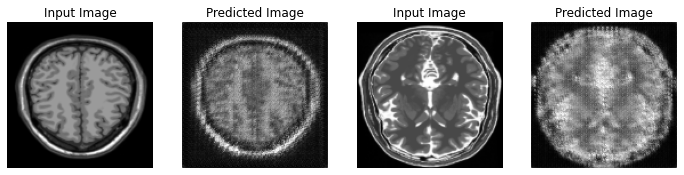

Saving checkpoint for epoch 17 at ./TrainedCGAN_Model\ckpt-17


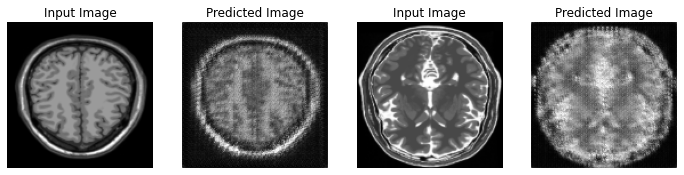

Saving checkpoint for epoch 18 at ./TrainedCGAN_Model\ckpt-18


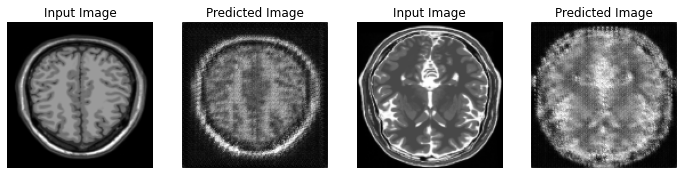

Saving checkpoint for epoch 19 at ./TrainedCGAN_Model\ckpt-19


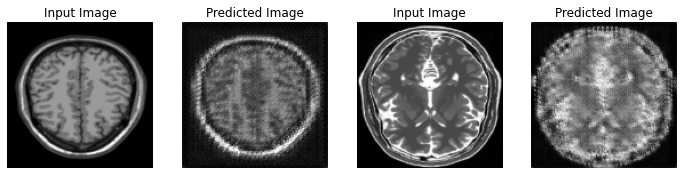

Saving checkpoint for epoch 20 at ./TrainedCGAN_Model\ckpt-20


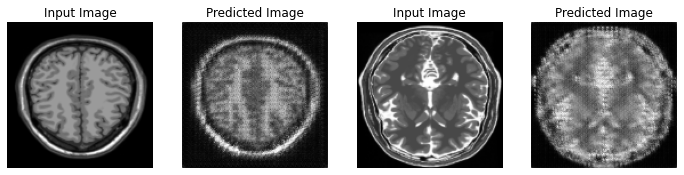

Saving checkpoint for epoch 21 at ./TrainedCGAN_Model\ckpt-21


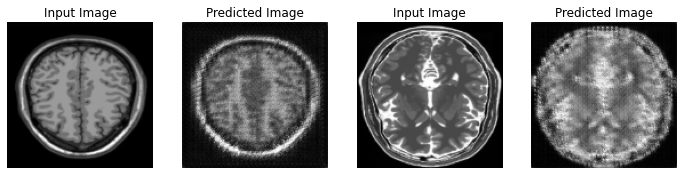

Saving checkpoint for epoch 22 at ./TrainedCGAN_Model\ckpt-22


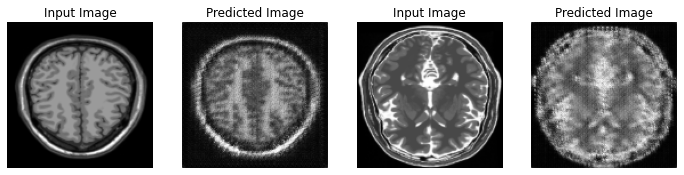

Saving checkpoint for epoch 23 at ./TrainedCGAN_Model\ckpt-23


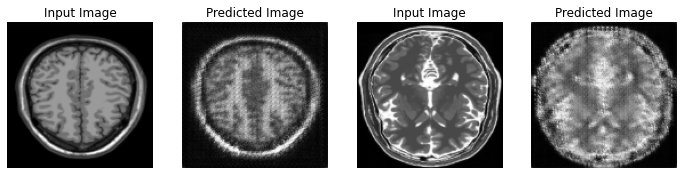

Saving checkpoint for epoch 24 at ./TrainedCGAN_Model\ckpt-24


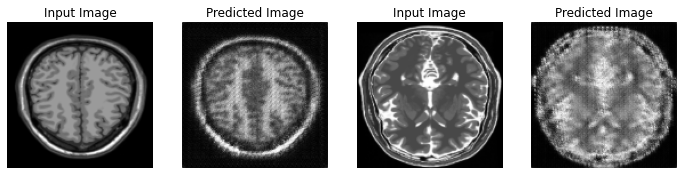

Saving checkpoint for epoch 25 at ./TrainedCGAN_Model\ckpt-25


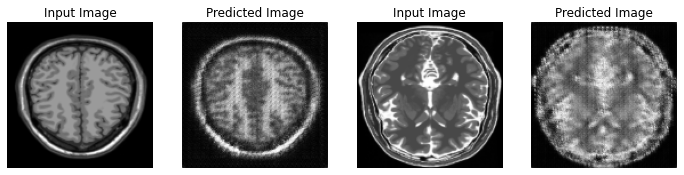

Saving checkpoint for epoch 26 at ./TrainedCGAN_Model\ckpt-26


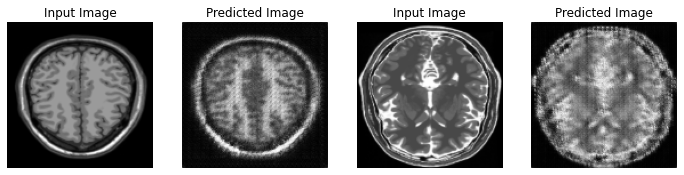

Saving checkpoint for epoch 27 at ./TrainedCGAN_Model\ckpt-27


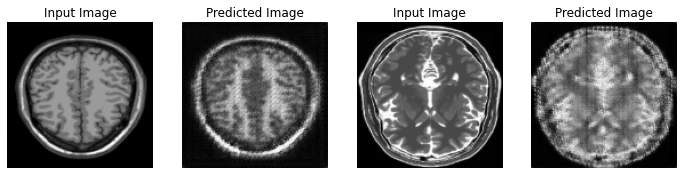

Saving checkpoint for epoch 28 at ./TrainedCGAN_Model\ckpt-28


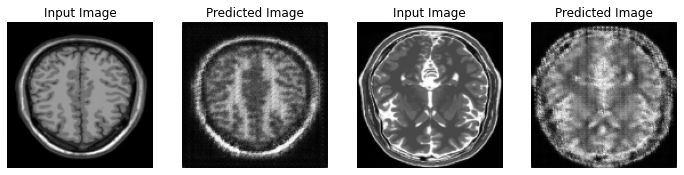

Saving checkpoint for epoch 29 at ./TrainedCGAN_Model\ckpt-29


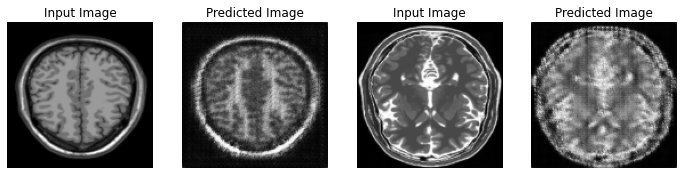

Saving checkpoint for epoch 30 at ./TrainedCGAN_Model\ckpt-30


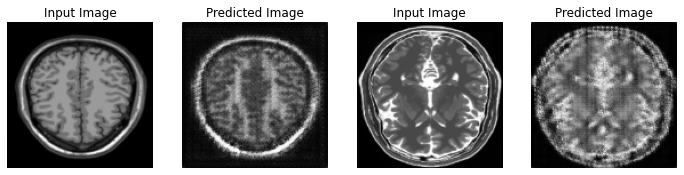

Saving checkpoint for epoch 31 at ./TrainedCGAN_Model\ckpt-31


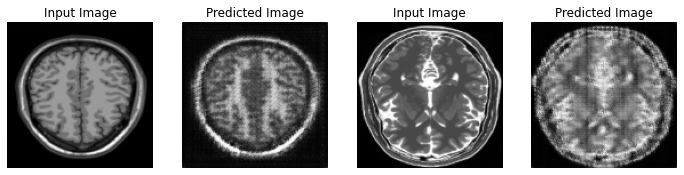

Saving checkpoint for epoch 32 at ./TrainedCGAN_Model\ckpt-32


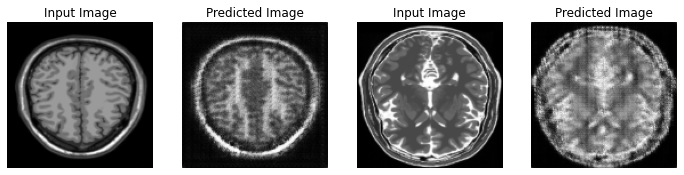

Saving checkpoint for epoch 33 at ./TrainedCGAN_Model\ckpt-33


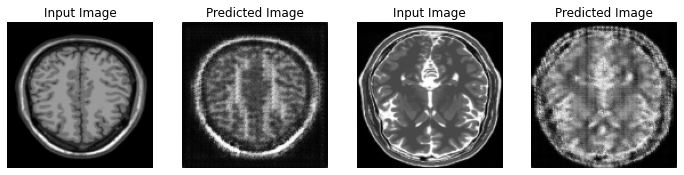

Saving checkpoint for epoch 34 at ./TrainedCGAN_Model\ckpt-34


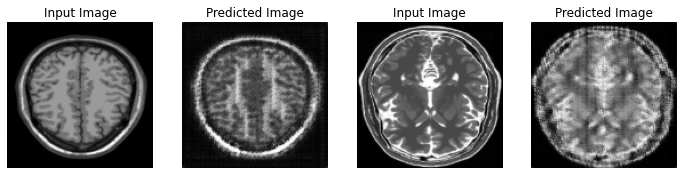

Saving checkpoint for epoch 35 at ./TrainedCGAN_Model\ckpt-35


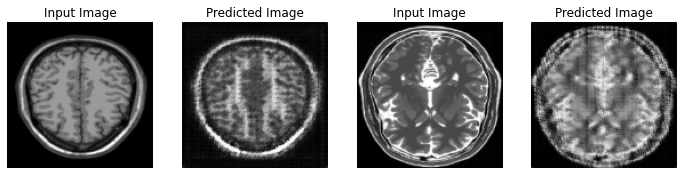

Saving checkpoint for epoch 36 at ./TrainedCGAN_Model\ckpt-36


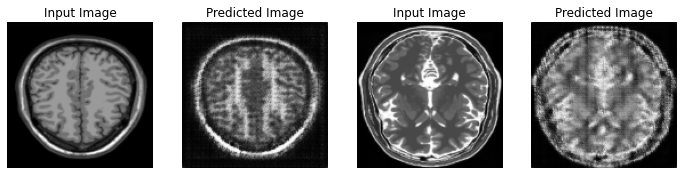

Saving checkpoint for epoch 37 at ./TrainedCGAN_Model\ckpt-37


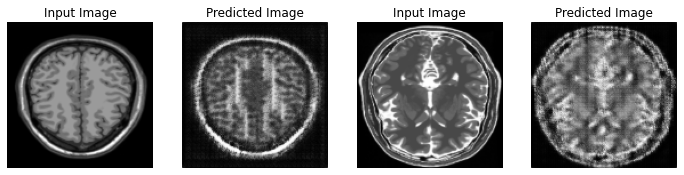

Saving checkpoint for epoch 38 at ./TrainedCGAN_Model\ckpt-38


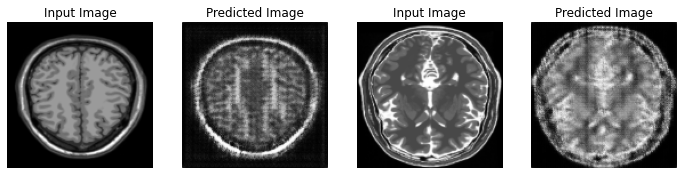

Saving checkpoint for epoch 39 at ./TrainedCGAN_Model\ckpt-39


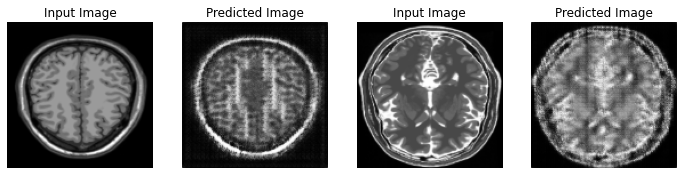

Saving checkpoint for epoch 40 at ./TrainedCGAN_Model\ckpt-40


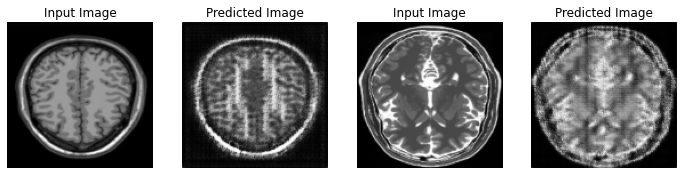

Saving checkpoint for epoch 41 at ./TrainedCGAN_Model\ckpt-41


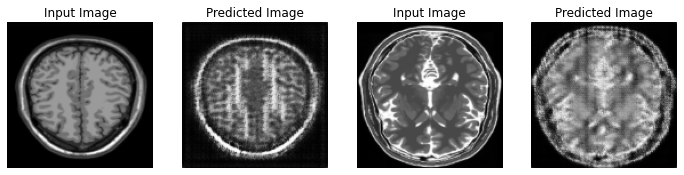

Saving checkpoint for epoch 42 at ./TrainedCGAN_Model\ckpt-42


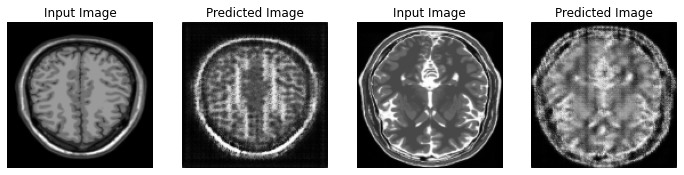

Saving checkpoint for epoch 43 at ./TrainedCGAN_Model\ckpt-43


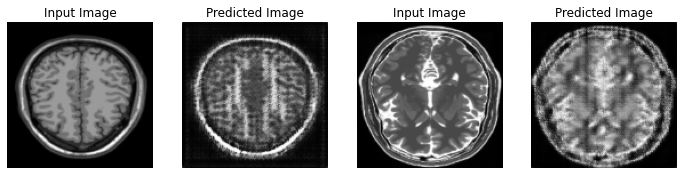

Saving checkpoint for epoch 44 at ./TrainedCGAN_Model\ckpt-44


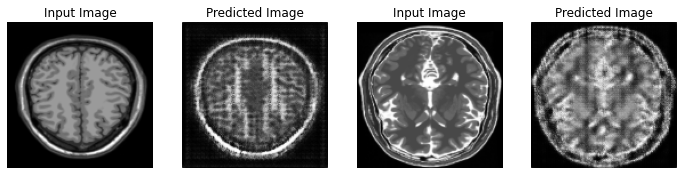

Saving checkpoint for epoch 45 at ./TrainedCGAN_Model\ckpt-45


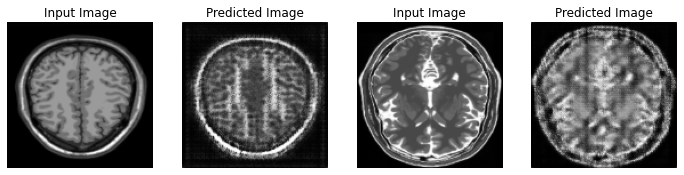

Saving checkpoint for epoch 46 at ./TrainedCGAN_Model\ckpt-46


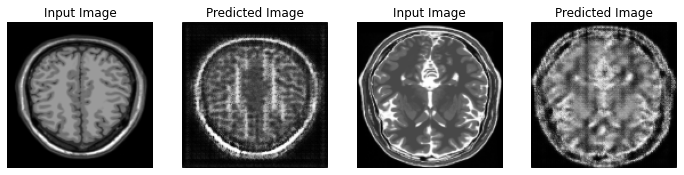

Saving checkpoint for epoch 47 at ./TrainedCGAN_Model\ckpt-47


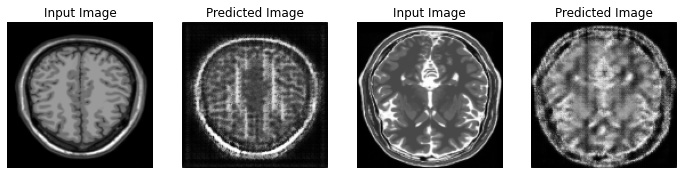

Saving checkpoint for epoch 48 at ./TrainedCGAN_Model\ckpt-48


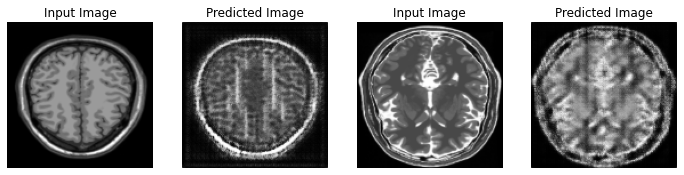

Saving checkpoint for epoch 49 at ./TrainedCGAN_Model\ckpt-49


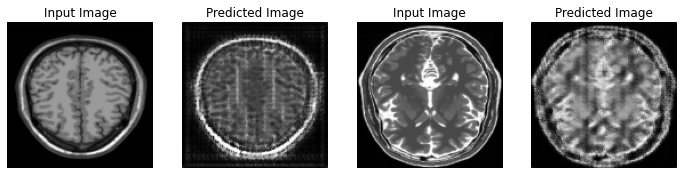

Saving checkpoint for epoch 50 at ./TrainedCGAN_Model\ckpt-50


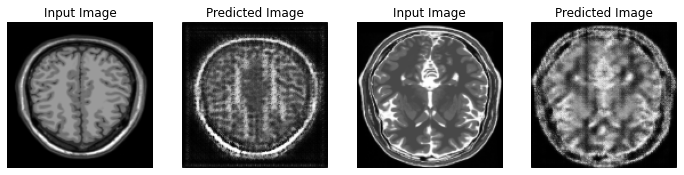

Saving checkpoint for epoch 51 at ./TrainedCGAN_Model\ckpt-51


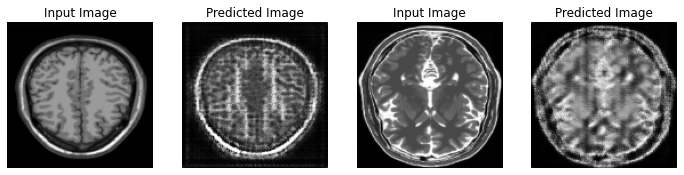

Saving checkpoint for epoch 52 at ./TrainedCGAN_Model\ckpt-52


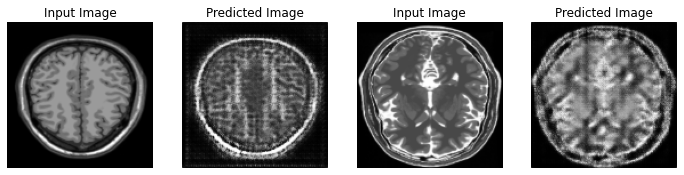

Saving checkpoint for epoch 53 at ./TrainedCGAN_Model\ckpt-53


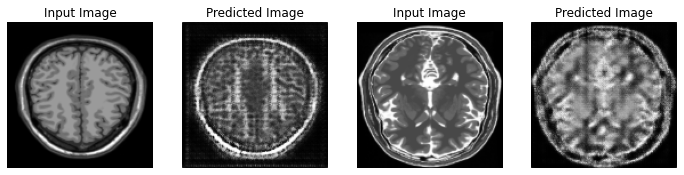

Saving checkpoint for epoch 54 at ./TrainedCGAN_Model\ckpt-54


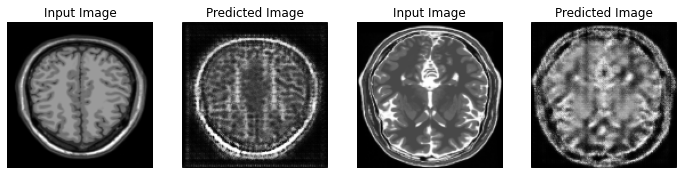

Saving checkpoint for epoch 55 at ./TrainedCGAN_Model\ckpt-55


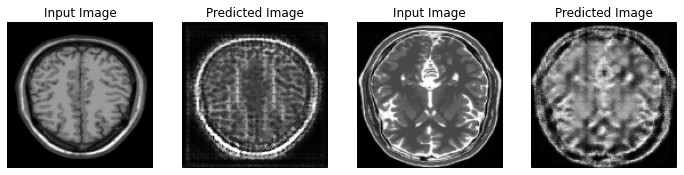

Saving checkpoint for epoch 56 at ./TrainedCGAN_Model\ckpt-56


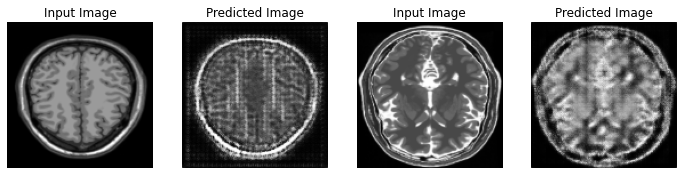

Saving checkpoint for epoch 57 at ./TrainedCGAN_Model\ckpt-57


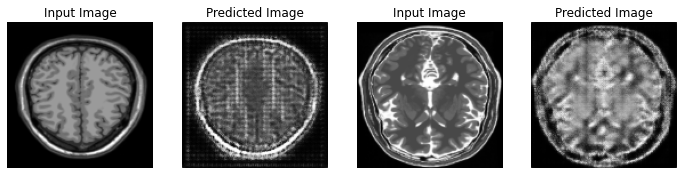

Saving checkpoint for epoch 58 at ./TrainedCGAN_Model\ckpt-58


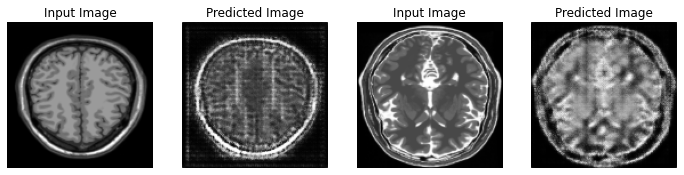

Saving checkpoint for epoch 59 at ./TrainedCGAN_Model\ckpt-59


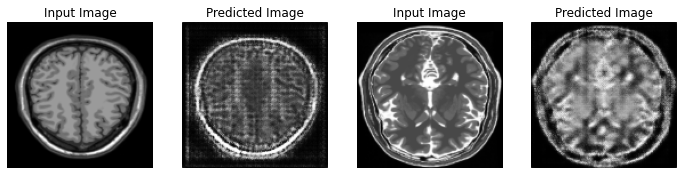

Saving checkpoint for epoch 60 at ./TrainedCGAN_Model\ckpt-60


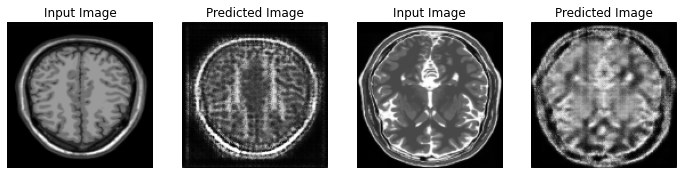

Saving checkpoint for epoch 61 at ./TrainedCGAN_Model\ckpt-61


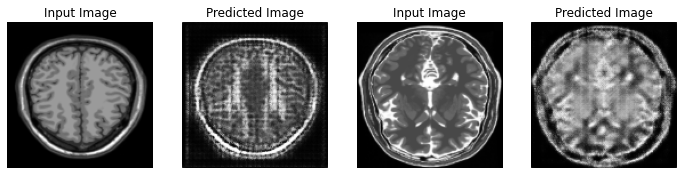

Saving checkpoint for epoch 62 at ./TrainedCGAN_Model\ckpt-62


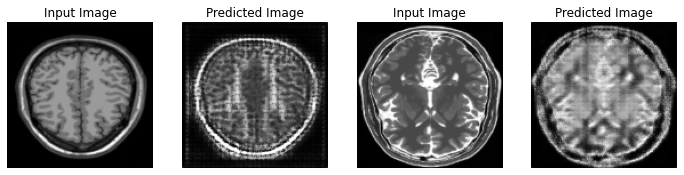

Saving checkpoint for epoch 63 at ./TrainedCGAN_Model\ckpt-63


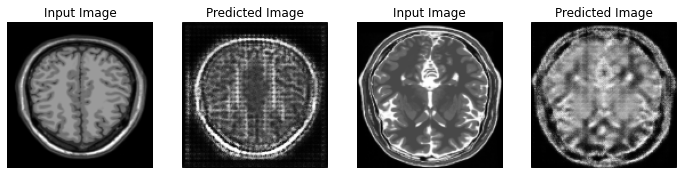

Saving checkpoint for epoch 64 at ./TrainedCGAN_Model\ckpt-64


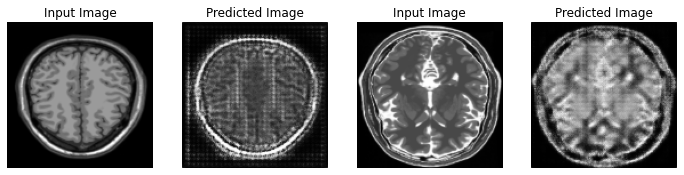

Saving checkpoint for epoch 65 at ./TrainedCGAN_Model\ckpt-65


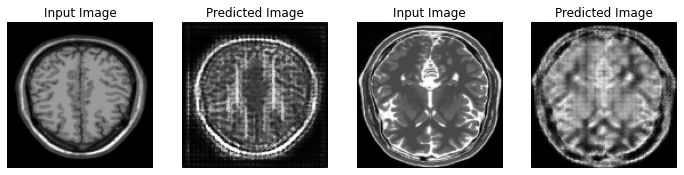

Saving checkpoint for epoch 66 at ./TrainedCGAN_Model\ckpt-66


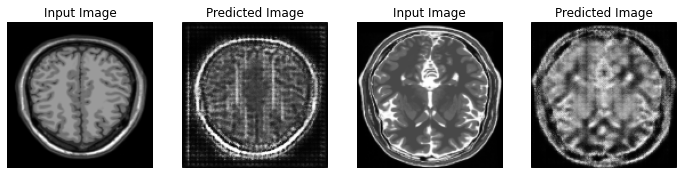

Saving checkpoint for epoch 67 at ./TrainedCGAN_Model\ckpt-67


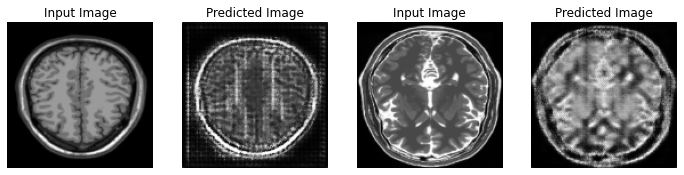

Saving checkpoint for epoch 68 at ./TrainedCGAN_Model\ckpt-68


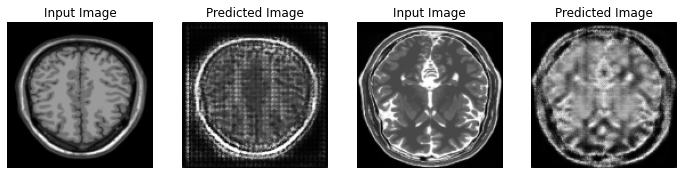

Saving checkpoint for epoch 69 at ./TrainedCGAN_Model\ckpt-69


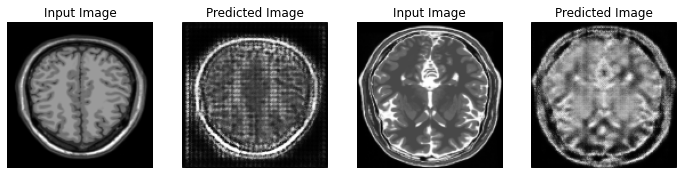

Saving checkpoint for epoch 70 at ./TrainedCGAN_Model\ckpt-70


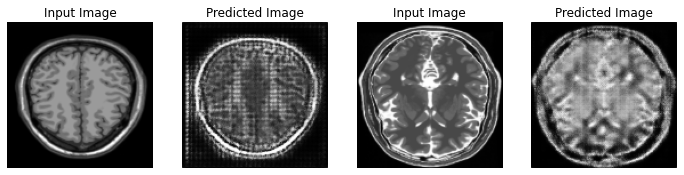

Saving checkpoint for epoch 71 at ./TrainedCGAN_Model\ckpt-71


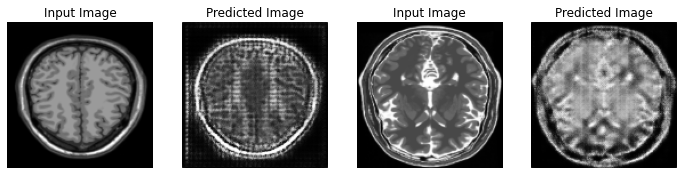

Saving checkpoint for epoch 72 at ./TrainedCGAN_Model\ckpt-72


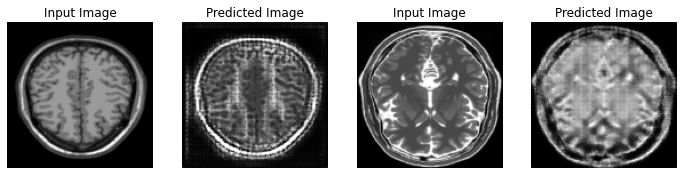

Saving checkpoint for epoch 73 at ./TrainedCGAN_Model\ckpt-73


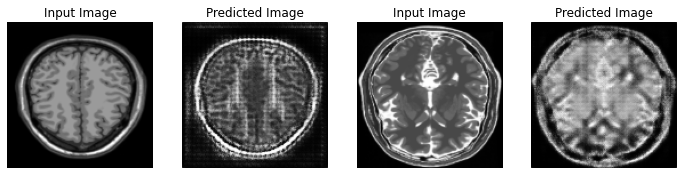

Saving checkpoint for epoch 74 at ./TrainedCGAN_Model\ckpt-74


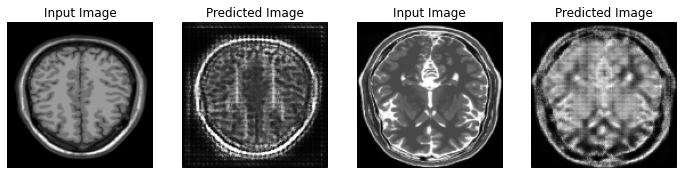

Saving checkpoint for epoch 75 at ./TrainedCGAN_Model\ckpt-75


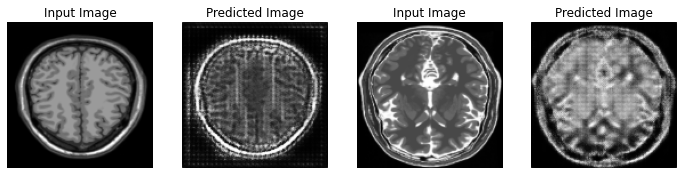

Saving checkpoint for epoch 76 at ./TrainedCGAN_Model\ckpt-76


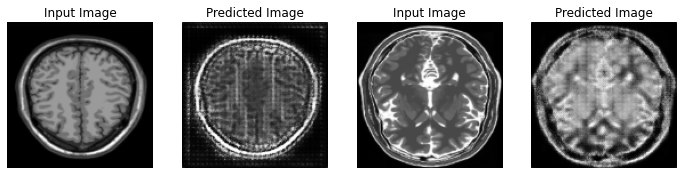

Saving checkpoint for epoch 77 at ./TrainedCGAN_Model\ckpt-77


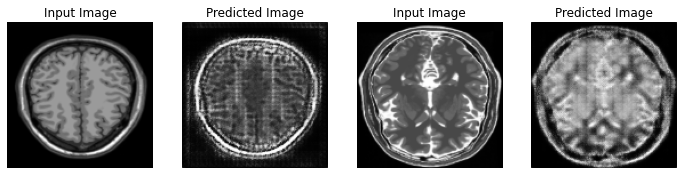

Saving checkpoint for epoch 78 at ./TrainedCGAN_Model\ckpt-78


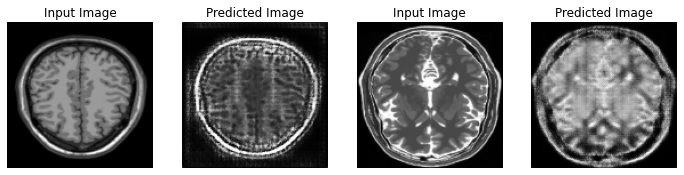

Saving checkpoint for epoch 79 at ./TrainedCGAN_Model\ckpt-79


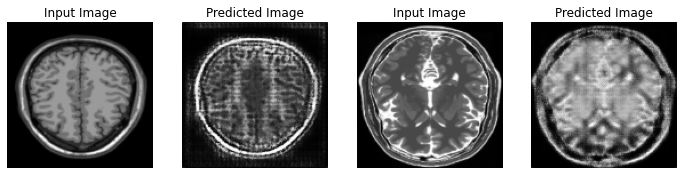

Saving checkpoint for epoch 80 at ./TrainedCGAN_Model\ckpt-80


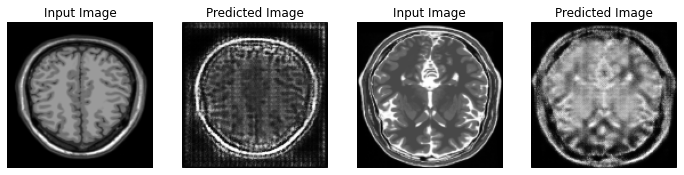

Saving checkpoint for epoch 81 at ./TrainedCGAN_Model\ckpt-81


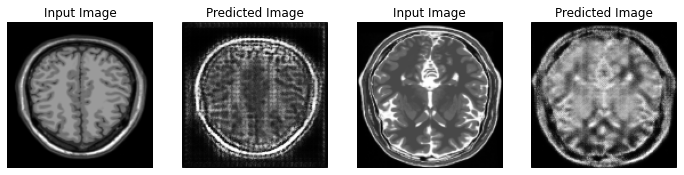

Saving checkpoint for epoch 82 at ./TrainedCGAN_Model\ckpt-82


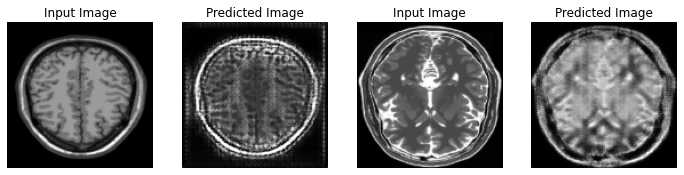

Saving checkpoint for epoch 83 at ./TrainedCGAN_Model\ckpt-83


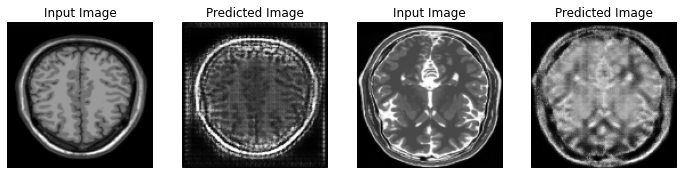

Saving checkpoint for epoch 84 at ./TrainedCGAN_Model\ckpt-84


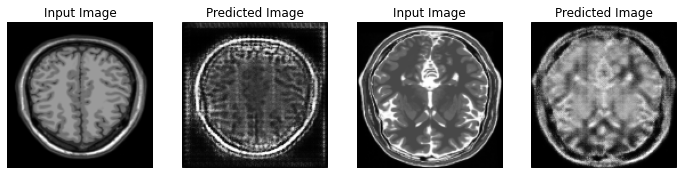

Saving checkpoint for epoch 85 at ./TrainedCGAN_Model\ckpt-85


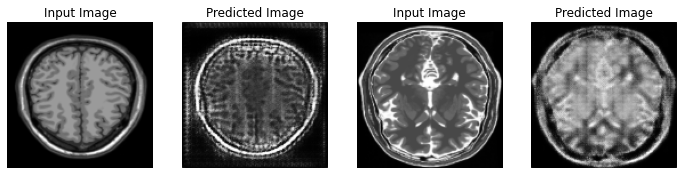

Saving checkpoint for epoch 86 at ./TrainedCGAN_Model\ckpt-86


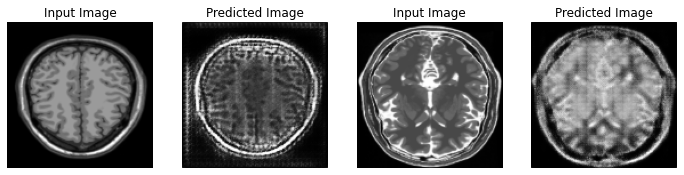

Saving checkpoint for epoch 87 at ./TrainedCGAN_Model\ckpt-87


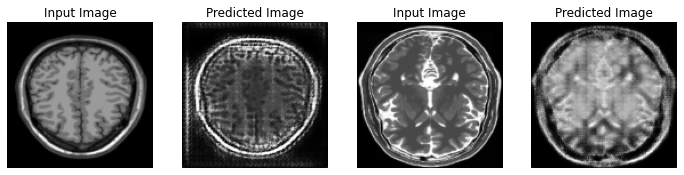

Saving checkpoint for epoch 88 at ./TrainedCGAN_Model\ckpt-88


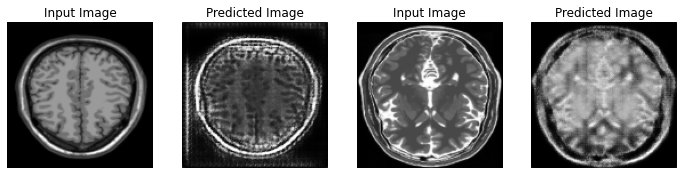

Saving checkpoint for epoch 89 at ./TrainedCGAN_Model\ckpt-89


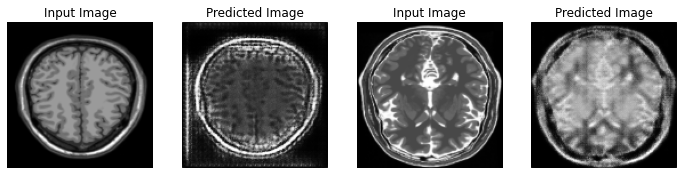

Saving checkpoint for epoch 90 at ./TrainedCGAN_Model\ckpt-90


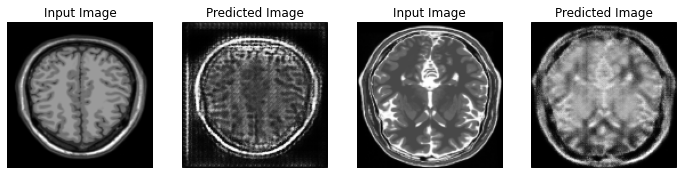

Saving checkpoint for epoch 91 at ./TrainedCGAN_Model\ckpt-91


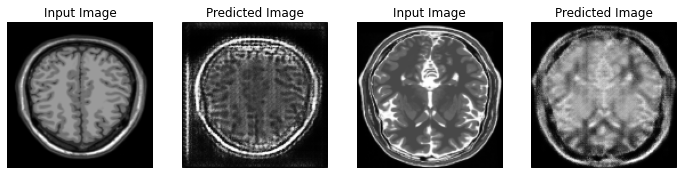

Saving checkpoint for epoch 92 at ./TrainedCGAN_Model\ckpt-92


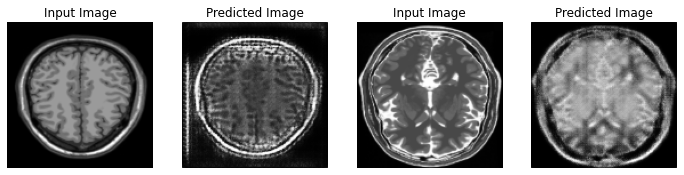

Saving checkpoint for epoch 93 at ./TrainedCGAN_Model\ckpt-93


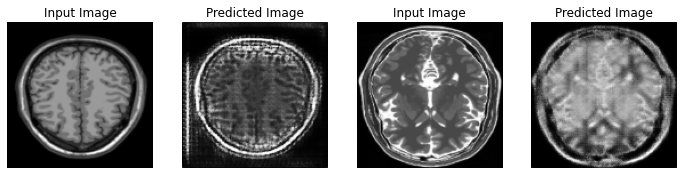

Saving checkpoint for epoch 94 at ./TrainedCGAN_Model\ckpt-94


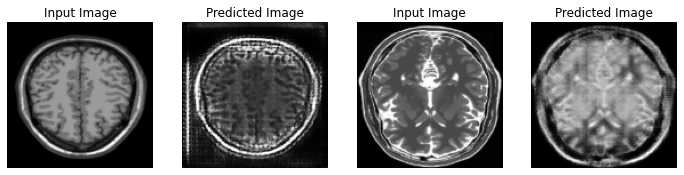

Saving checkpoint for epoch 95 at ./TrainedCGAN_Model\ckpt-95


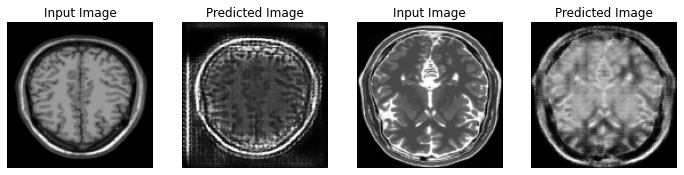

Saving checkpoint for epoch 96 at ./TrainedCGAN_Model\ckpt-96


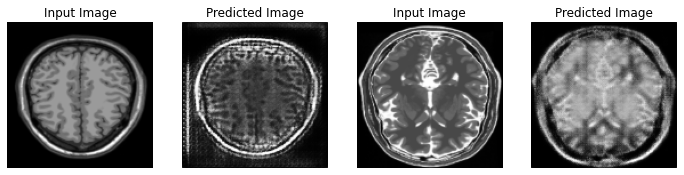

Saving checkpoint for epoch 97 at ./TrainedCGAN_Model\ckpt-97


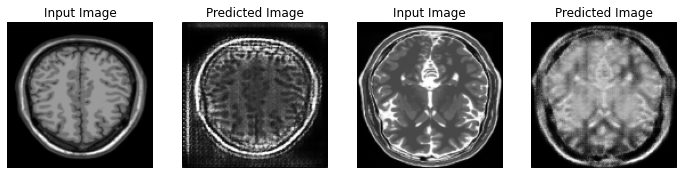

Saving checkpoint for epoch 98 at ./TrainedCGAN_Model\ckpt-98


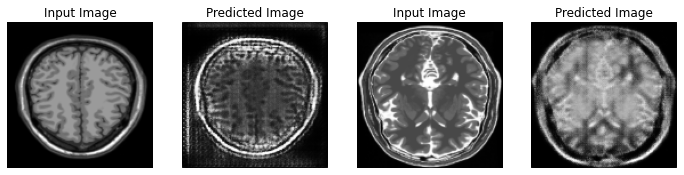

Saving checkpoint for epoch 99 at ./TrainedCGAN_Model\ckpt-99


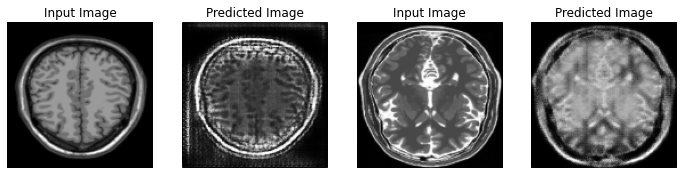

Saving checkpoint for epoch 100 at ./TrainedCGAN_Model\ckpt-100


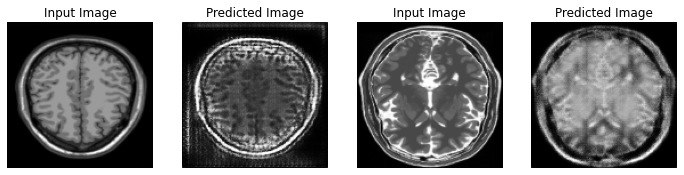

Saving checkpoint for epoch 101 at ./TrainedCGAN_Model\ckpt-101


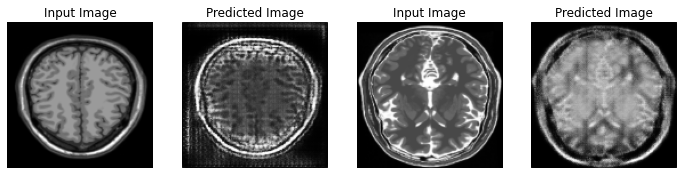

Saving checkpoint for epoch 102 at ./TrainedCGAN_Model\ckpt-102


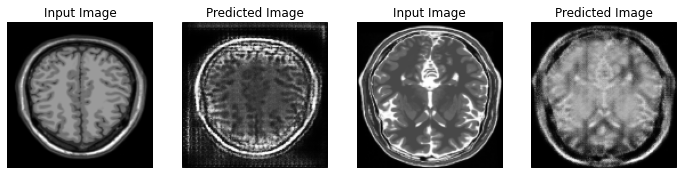

Saving checkpoint for epoch 103 at ./TrainedCGAN_Model\ckpt-103


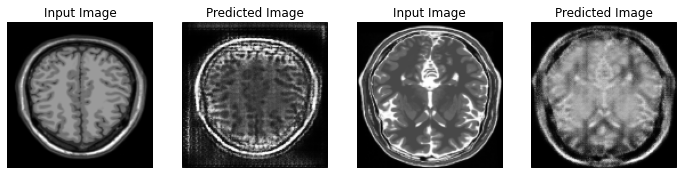

Saving checkpoint for epoch 104 at ./TrainedCGAN_Model\ckpt-104


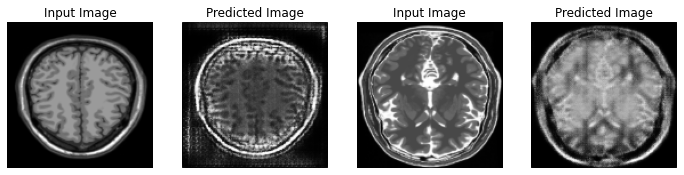

Saving checkpoint for epoch 105 at ./TrainedCGAN_Model\ckpt-105


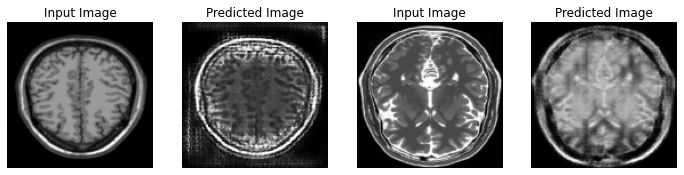

Saving checkpoint for epoch 106 at ./TrainedCGAN_Model\ckpt-106


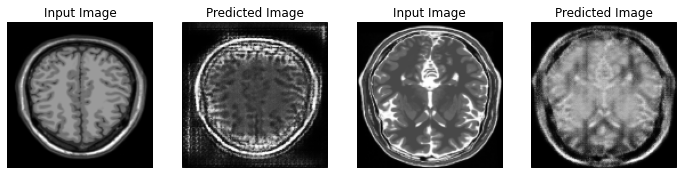

Saving checkpoint for epoch 107 at ./TrainedCGAN_Model\ckpt-107


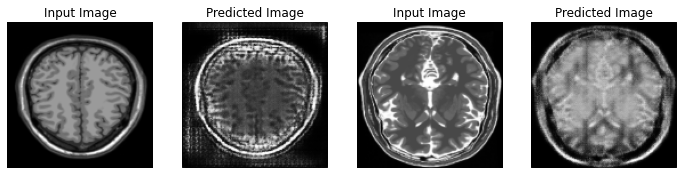

Saving checkpoint for epoch 108 at ./TrainedCGAN_Model\ckpt-108


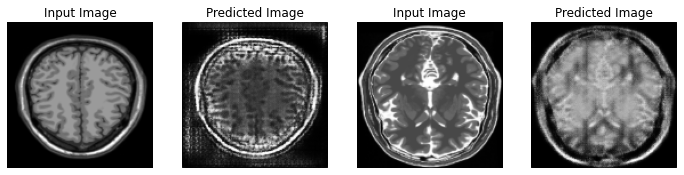

Saving checkpoint for epoch 109 at ./TrainedCGAN_Model\ckpt-109


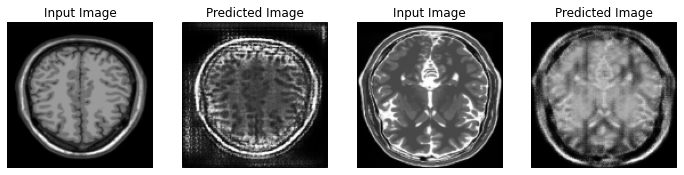

Saving checkpoint for epoch 110 at ./TrainedCGAN_Model\ckpt-110


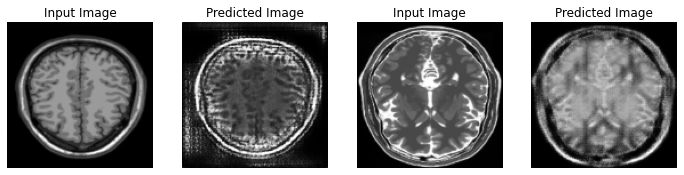

Saving checkpoint for epoch 111 at ./TrainedCGAN_Model\ckpt-111


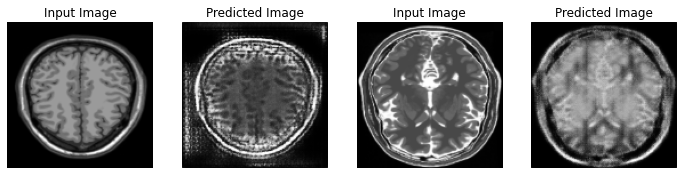

Saving checkpoint for epoch 112 at ./TrainedCGAN_Model\ckpt-112


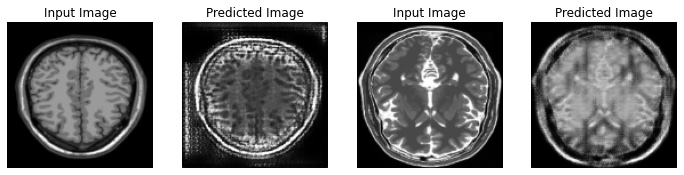

Saving checkpoint for epoch 113 at ./TrainedCGAN_Model\ckpt-113


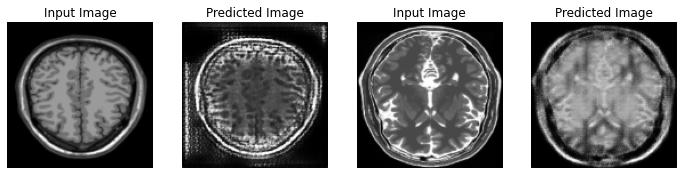

Saving checkpoint for epoch 114 at ./TrainedCGAN_Model\ckpt-114


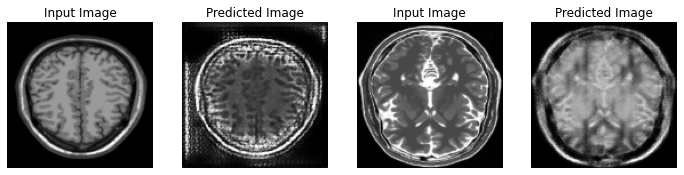

Saving checkpoint for epoch 115 at ./TrainedCGAN_Model\ckpt-115


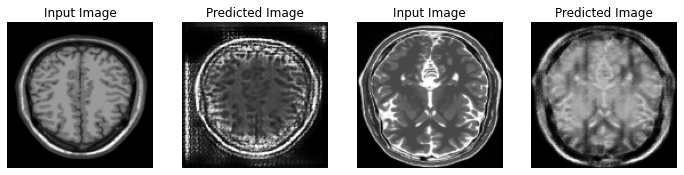

Saving checkpoint for epoch 116 at ./TrainedCGAN_Model\ckpt-116


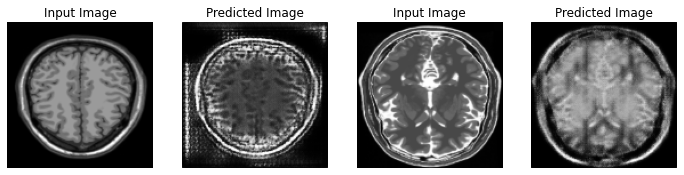

Saving checkpoint for epoch 117 at ./TrainedCGAN_Model\ckpt-117


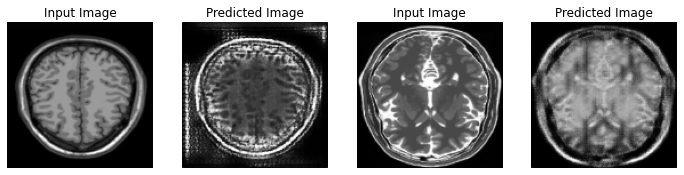

Saving checkpoint for epoch 118 at ./TrainedCGAN_Model\ckpt-118


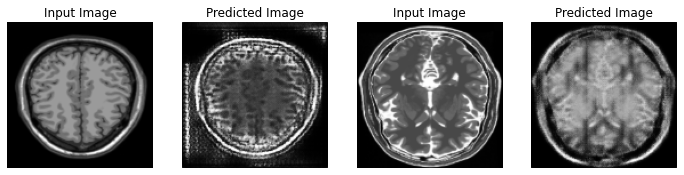

Saving checkpoint for epoch 119 at ./TrainedCGAN_Model\ckpt-119


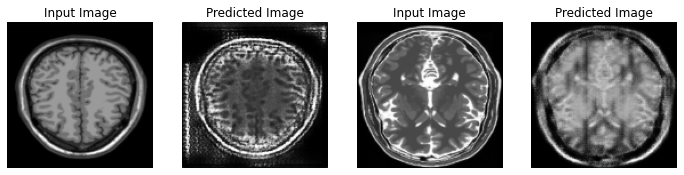

Saving checkpoint for epoch 120 at ./TrainedCGAN_Model\ckpt-120


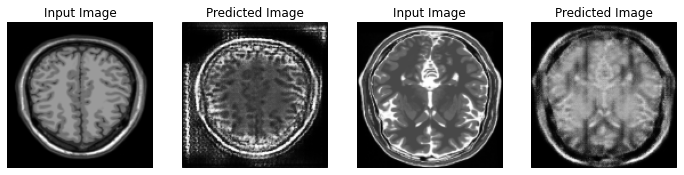

Saving checkpoint for epoch 121 at ./TrainedCGAN_Model\ckpt-121


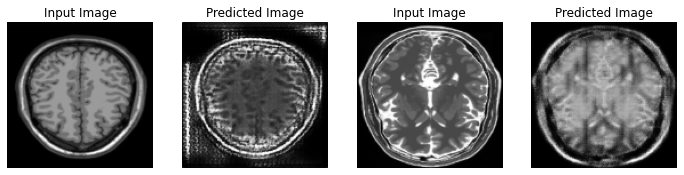

Saving checkpoint for epoch 122 at ./TrainedCGAN_Model\ckpt-122


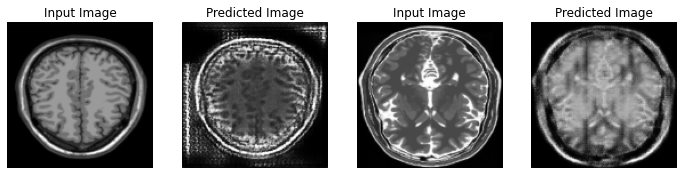

Saving checkpoint for epoch 123 at ./TrainedCGAN_Model\ckpt-123


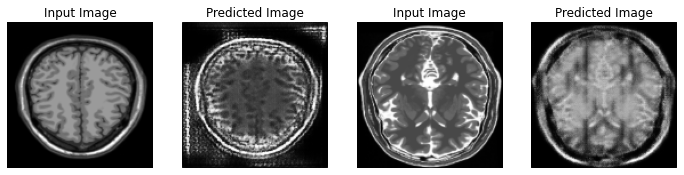

Saving checkpoint for epoch 124 at ./TrainedCGAN_Model\ckpt-124


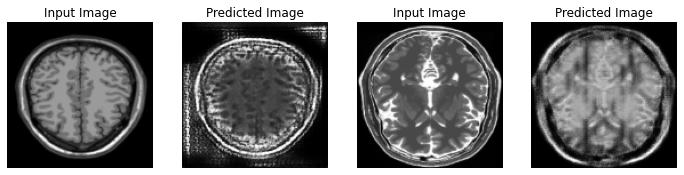

Saving checkpoint for epoch 125 at ./TrainedCGAN_Model\ckpt-125


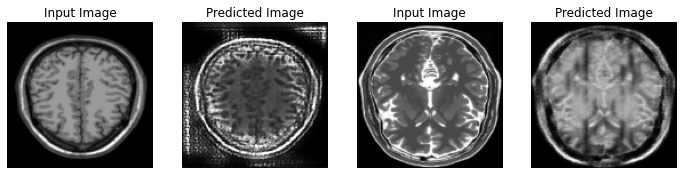

Saving checkpoint for epoch 126 at ./TrainedCGAN_Model\ckpt-126


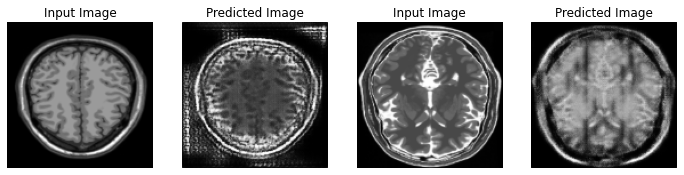

Saving checkpoint for epoch 127 at ./TrainedCGAN_Model\ckpt-127


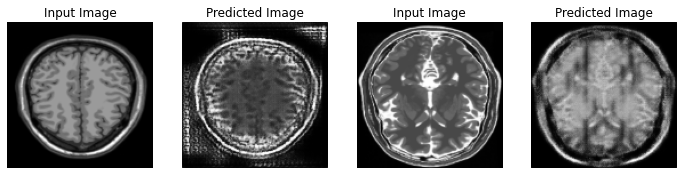

Saving checkpoint for epoch 128 at ./TrainedCGAN_Model\ckpt-128


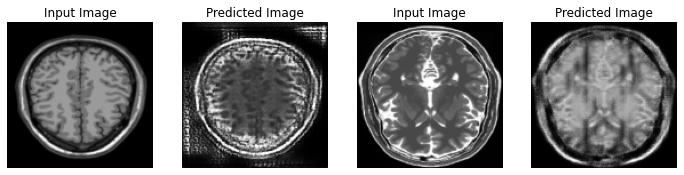

Saving checkpoint for epoch 129 at ./TrainedCGAN_Model\ckpt-129


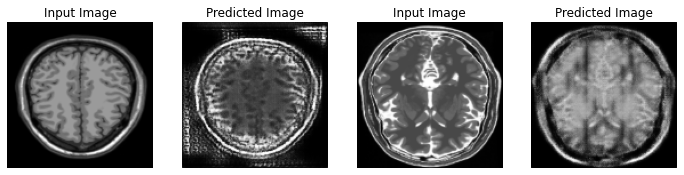

Saving checkpoint for epoch 130 at ./TrainedCGAN_Model\ckpt-130


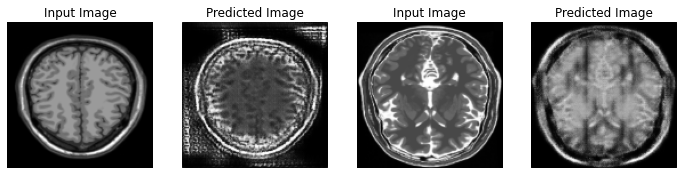

Saving checkpoint for epoch 131 at ./TrainedCGAN_Model\ckpt-131


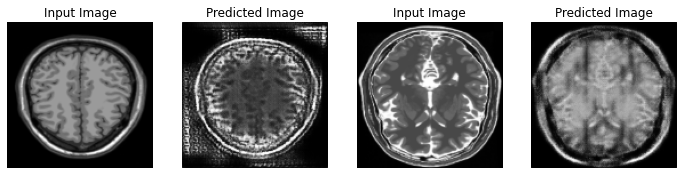

Saving checkpoint for epoch 132 at ./TrainedCGAN_Model\ckpt-132


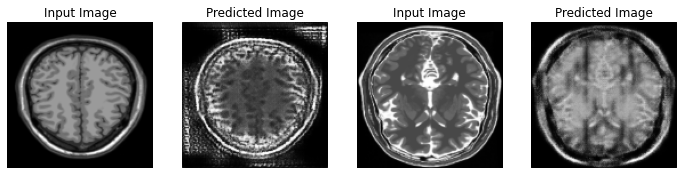

Saving checkpoint for epoch 133 at ./TrainedCGAN_Model\ckpt-133


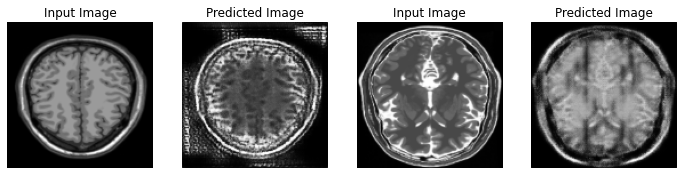

Saving checkpoint for epoch 134 at ./TrainedCGAN_Model\ckpt-134


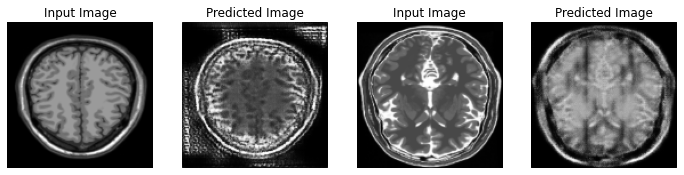

Saving checkpoint for epoch 135 at ./TrainedCGAN_Model\ckpt-135


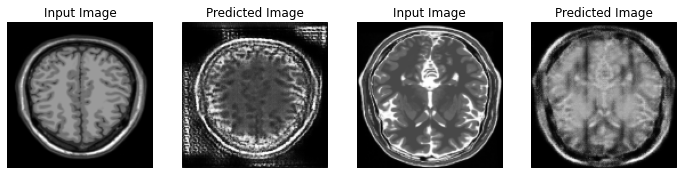

Saving checkpoint for epoch 136 at ./TrainedCGAN_Model\ckpt-136


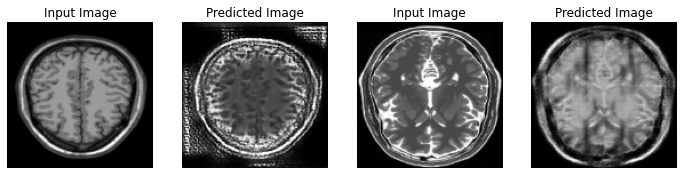

Saving checkpoint for epoch 137 at ./TrainedCGAN_Model\ckpt-137


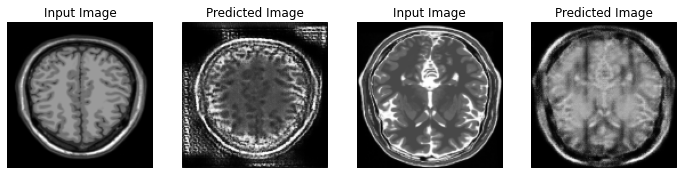

Saving checkpoint for epoch 138 at ./TrainedCGAN_Model\ckpt-138


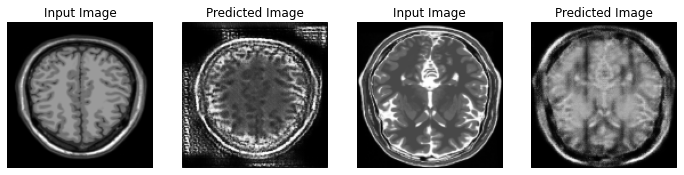

Saving checkpoint for epoch 139 at ./TrainedCGAN_Model\ckpt-139


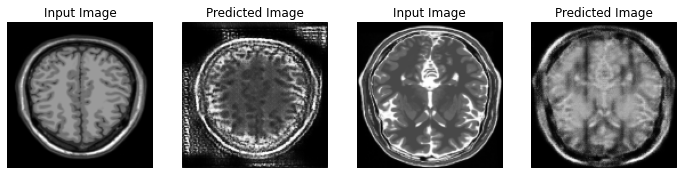

Saving checkpoint for epoch 140 at ./TrainedCGAN_Model\ckpt-140


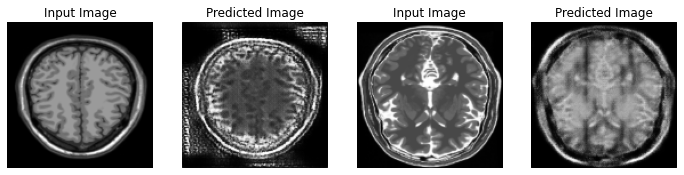

Saving checkpoint for epoch 141 at ./TrainedCGAN_Model\ckpt-141


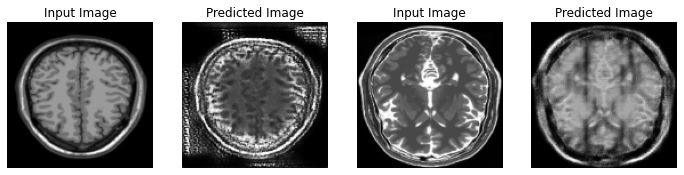

Saving checkpoint for epoch 142 at ./TrainedCGAN_Model\ckpt-142


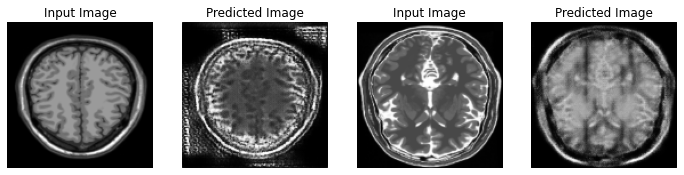

Saving checkpoint for epoch 143 at ./TrainedCGAN_Model\ckpt-143


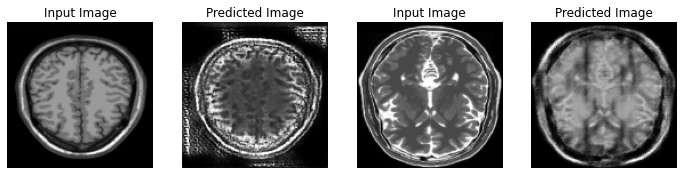

Saving checkpoint for epoch 144 at ./TrainedCGAN_Model\ckpt-144


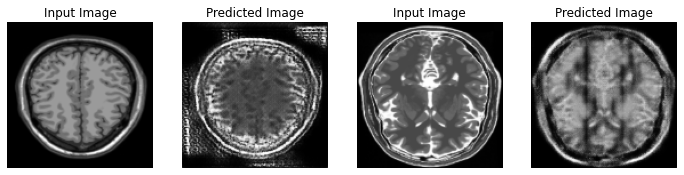

Saving checkpoint for epoch 145 at ./TrainedCGAN_Model\ckpt-145


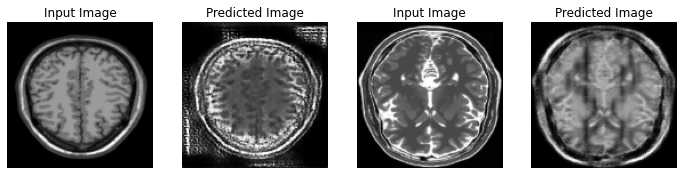

Saving checkpoint for epoch 146 at ./TrainedCGAN_Model\ckpt-146


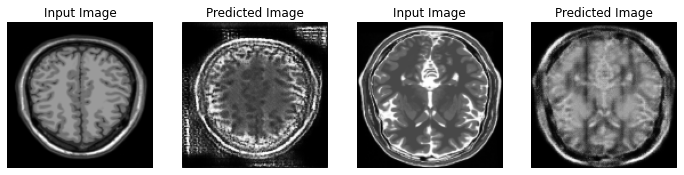

Saving checkpoint for epoch 147 at ./TrainedCGAN_Model\ckpt-147


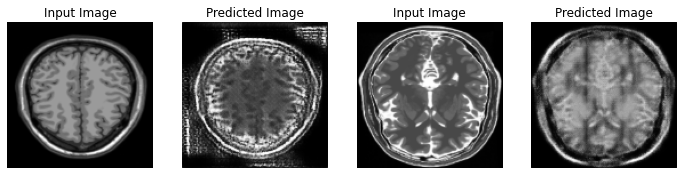

Saving checkpoint for epoch 148 at ./TrainedCGAN_Model\ckpt-148


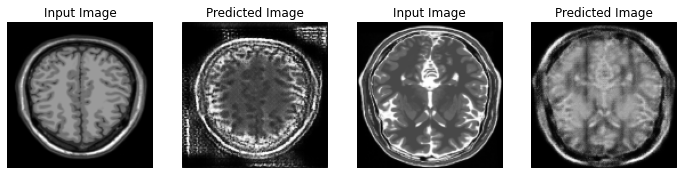

Saving checkpoint for epoch 149 at ./TrainedCGAN_Model\ckpt-149


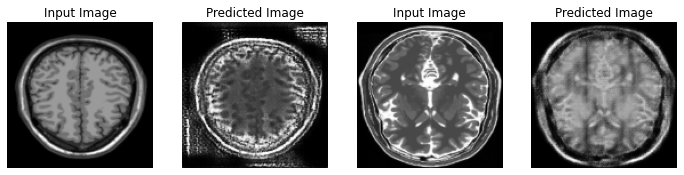

Saving checkpoint for epoch 150 at ./TrainedCGAN_Model\ckpt-150


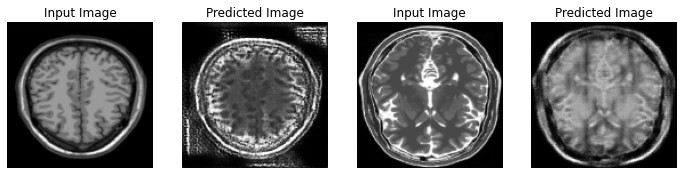

Saving checkpoint for epoch 151 at ./TrainedCGAN_Model\ckpt-151


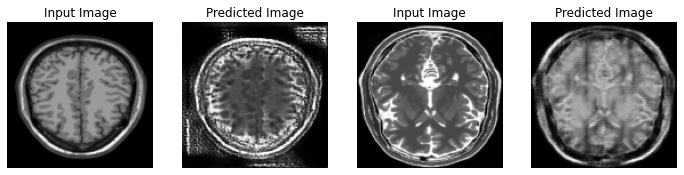

Saving checkpoint for epoch 152 at ./TrainedCGAN_Model\ckpt-152


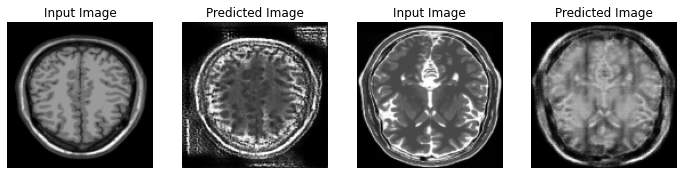

Saving checkpoint for epoch 153 at ./TrainedCGAN_Model\ckpt-153


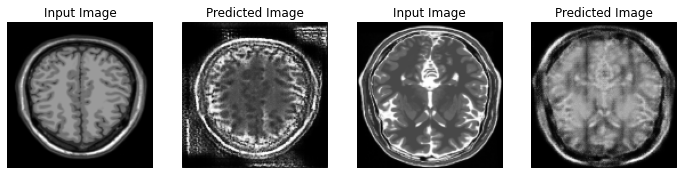

Saving checkpoint for epoch 154 at ./TrainedCGAN_Model\ckpt-154


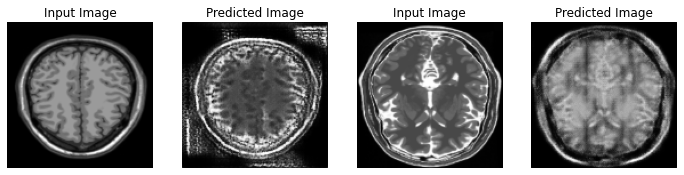

Saving checkpoint for epoch 155 at ./TrainedCGAN_Model\ckpt-155


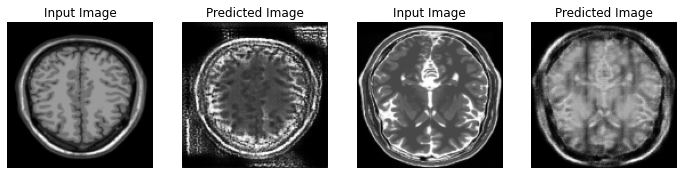

Saving checkpoint for epoch 156 at ./TrainedCGAN_Model\ckpt-156


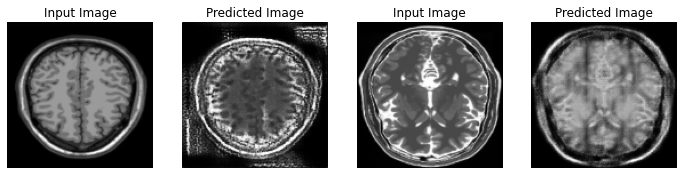

Saving checkpoint for epoch 157 at ./TrainedCGAN_Model\ckpt-157


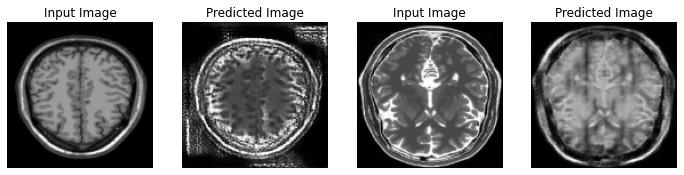

Saving checkpoint for epoch 158 at ./TrainedCGAN_Model\ckpt-158


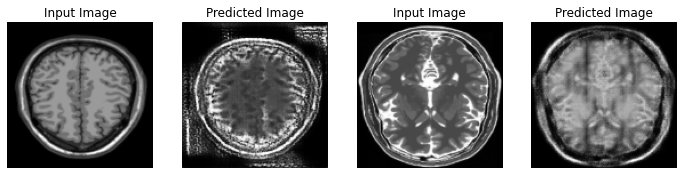

Saving checkpoint for epoch 159 at ./TrainedCGAN_Model\ckpt-159


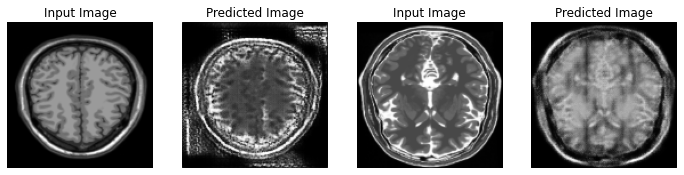

Saving checkpoint for epoch 160 at ./TrainedCGAN_Model\ckpt-160


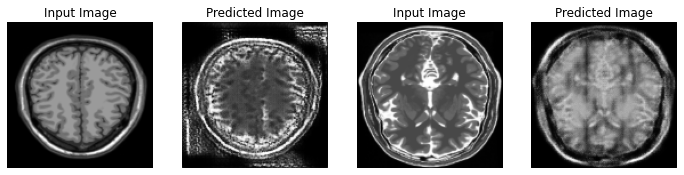

Saving checkpoint for epoch 161 at ./TrainedCGAN_Model\ckpt-161


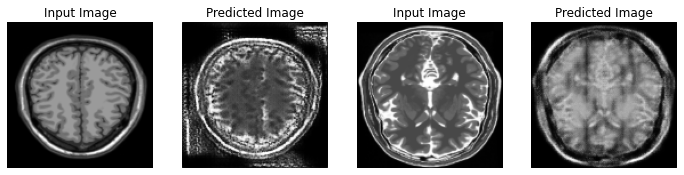

Saving checkpoint for epoch 162 at ./TrainedCGAN_Model\ckpt-162


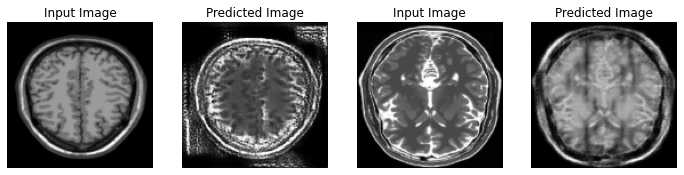

Saving checkpoint for epoch 163 at ./TrainedCGAN_Model\ckpt-163


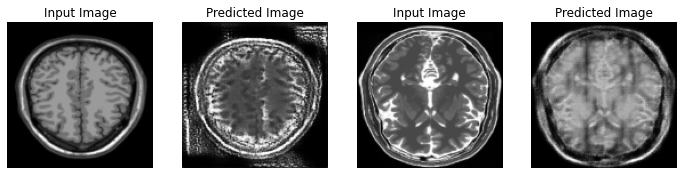

Saving checkpoint for epoch 164 at ./TrainedCGAN_Model\ckpt-164


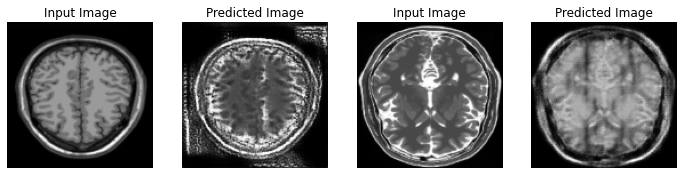

Saving checkpoint for epoch 165 at ./TrainedCGAN_Model\ckpt-165


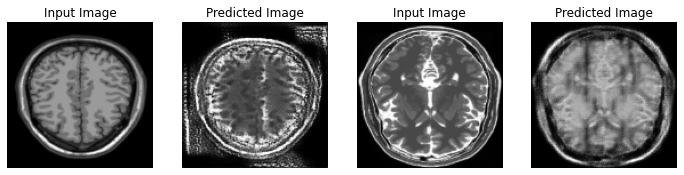

Saving checkpoint for epoch 166 at ./TrainedCGAN_Model\ckpt-166


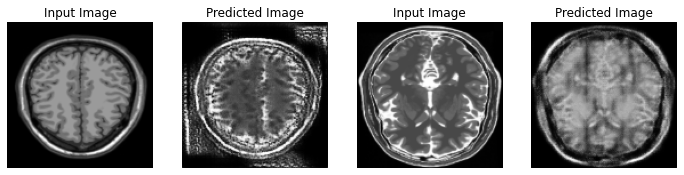

Saving checkpoint for epoch 167 at ./TrainedCGAN_Model\ckpt-167


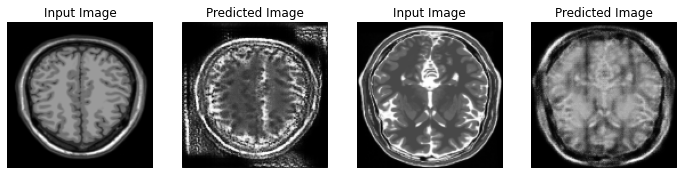

Saving checkpoint for epoch 168 at ./TrainedCGAN_Model\ckpt-168


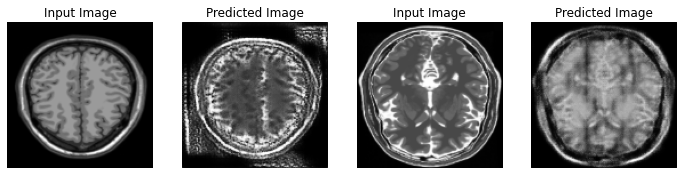

Saving checkpoint for epoch 169 at ./TrainedCGAN_Model\ckpt-169


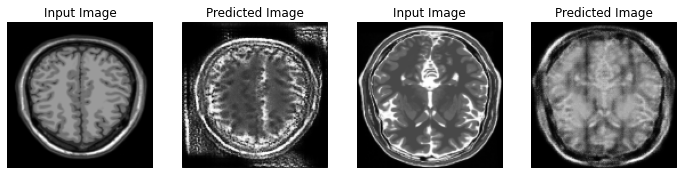

Saving checkpoint for epoch 170 at ./TrainedCGAN_Model\ckpt-170


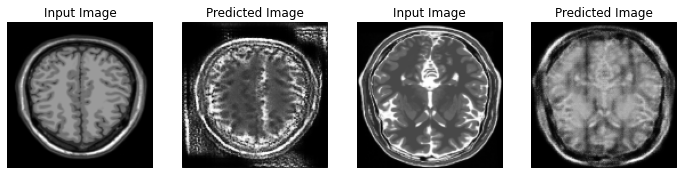

Saving checkpoint for epoch 171 at ./TrainedCGAN_Model\ckpt-171


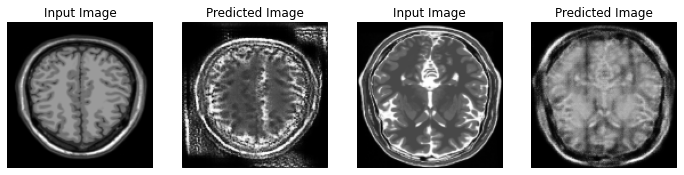

Saving checkpoint for epoch 172 at ./TrainedCGAN_Model\ckpt-172


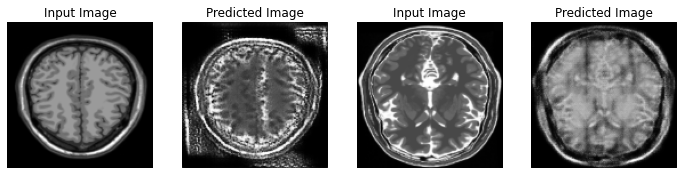

Saving checkpoint for epoch 173 at ./TrainedCGAN_Model\ckpt-173


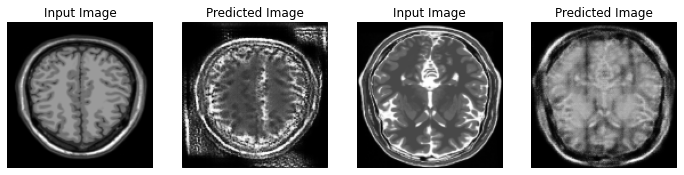

Saving checkpoint for epoch 174 at ./TrainedCGAN_Model\ckpt-174


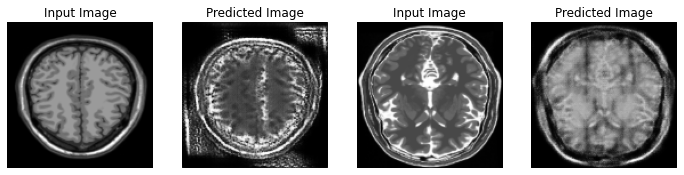

Saving checkpoint for epoch 175 at ./TrainedCGAN_Model\ckpt-175


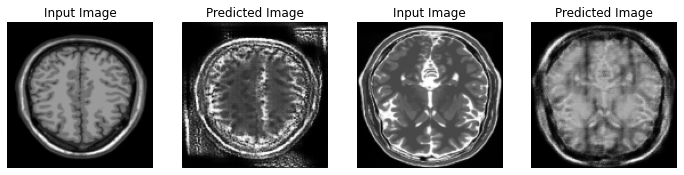

Saving checkpoint for epoch 176 at ./TrainedCGAN_Model\ckpt-176


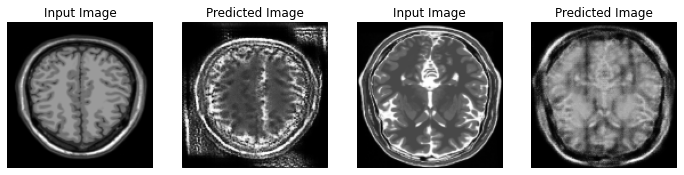

Saving checkpoint for epoch 177 at ./TrainedCGAN_Model\ckpt-177


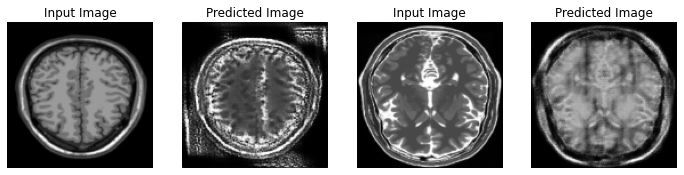

Saving checkpoint for epoch 178 at ./TrainedCGAN_Model\ckpt-178


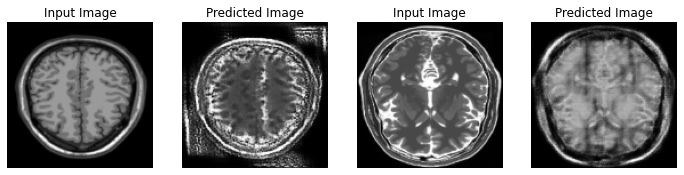

Saving checkpoint for epoch 179 at ./TrainedCGAN_Model\ckpt-179


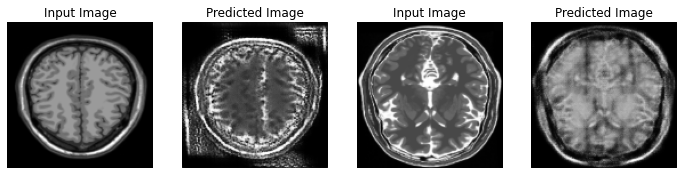

Saving checkpoint for epoch 180 at ./TrainedCGAN_Model\ckpt-180


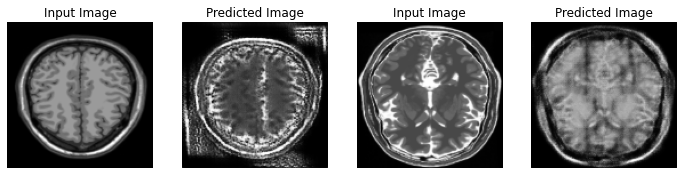

Saving checkpoint for epoch 181 at ./TrainedCGAN_Model\ckpt-181


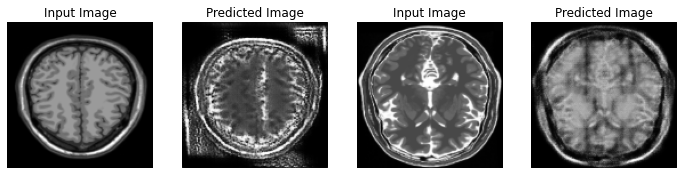

Saving checkpoint for epoch 182 at ./TrainedCGAN_Model\ckpt-182


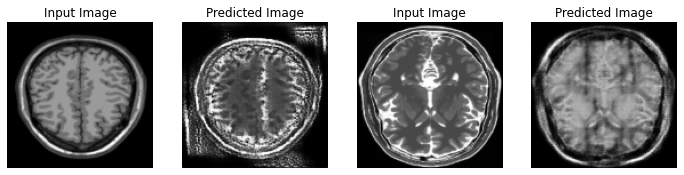

Saving checkpoint for epoch 183 at ./TrainedCGAN_Model\ckpt-183


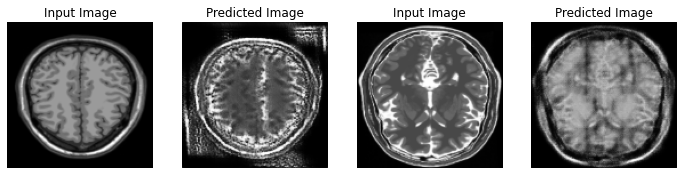

Saving checkpoint for epoch 184 at ./TrainedCGAN_Model\ckpt-184


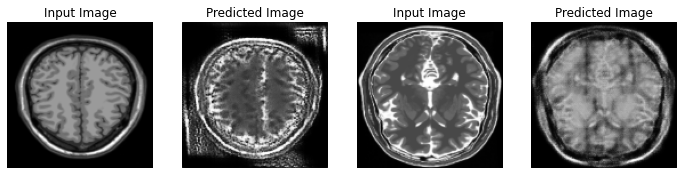

Saving checkpoint for epoch 185 at ./TrainedCGAN_Model\ckpt-185


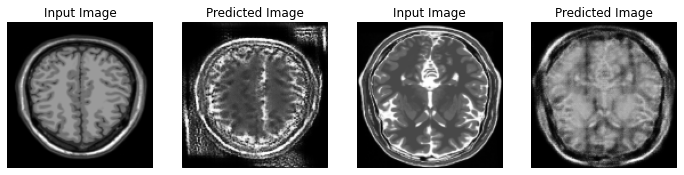

Saving checkpoint for epoch 186 at ./TrainedCGAN_Model\ckpt-186


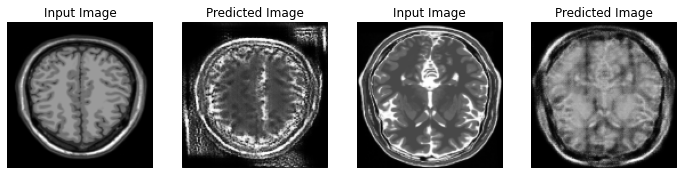

Saving checkpoint for epoch 187 at ./TrainedCGAN_Model\ckpt-187


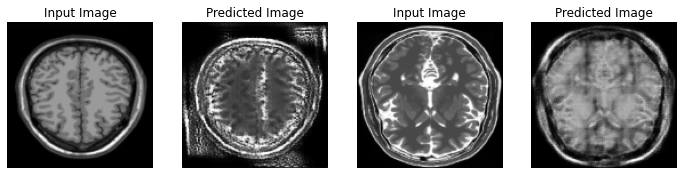

Saving checkpoint for epoch 188 at ./TrainedCGAN_Model\ckpt-188


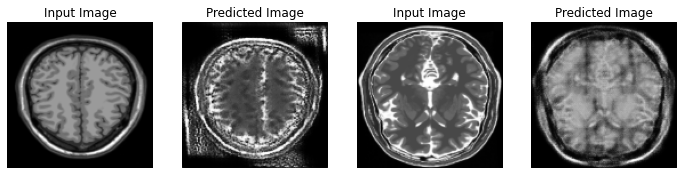

Saving checkpoint for epoch 189 at ./TrainedCGAN_Model\ckpt-189


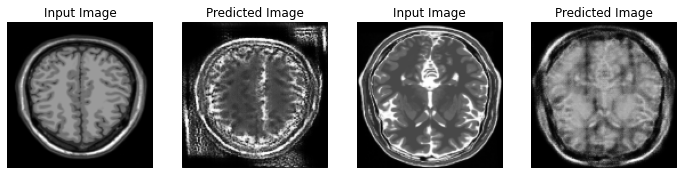

Saving checkpoint for epoch 190 at ./TrainedCGAN_Model\ckpt-190


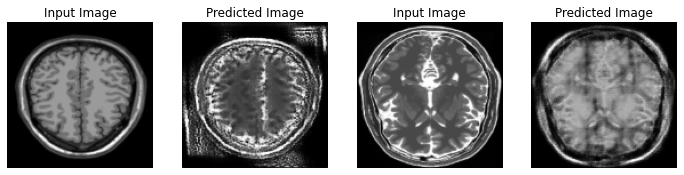

Saving checkpoint for epoch 191 at ./TrainedCGAN_Model\ckpt-191


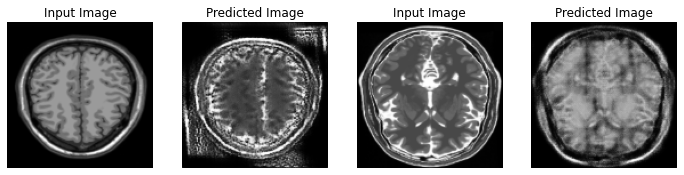

Saving checkpoint for epoch 192 at ./TrainedCGAN_Model\ckpt-192


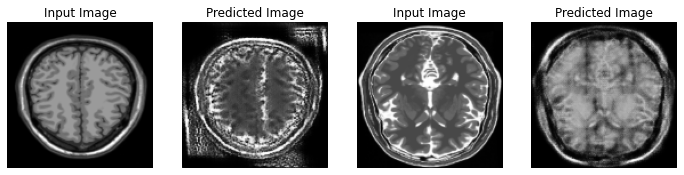

Saving checkpoint for epoch 193 at ./TrainedCGAN_Model\ckpt-193


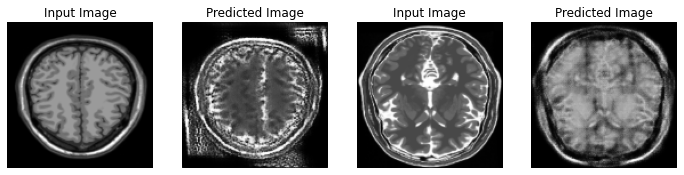

Saving checkpoint for epoch 194 at ./TrainedCGAN_Model\ckpt-194


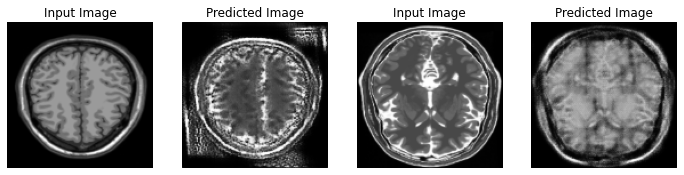

Saving checkpoint for epoch 195 at ./TrainedCGAN_Model\ckpt-195


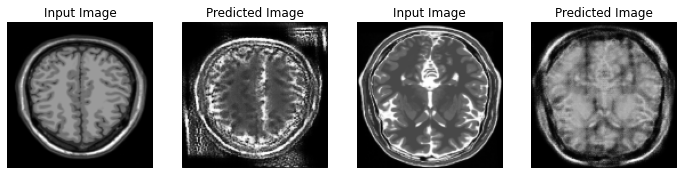

Saving checkpoint for epoch 196 at ./TrainedCGAN_Model\ckpt-196


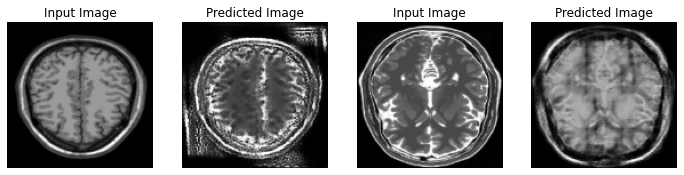

Saving checkpoint for epoch 197 at ./TrainedCGAN_Model\ckpt-197


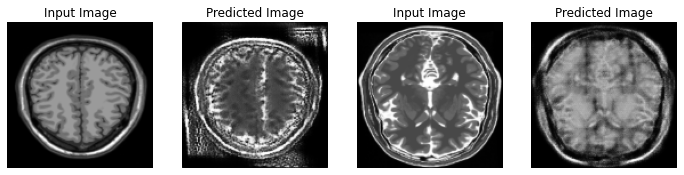

Saving checkpoint for epoch 198 at ./TrainedCGAN_Model\ckpt-198


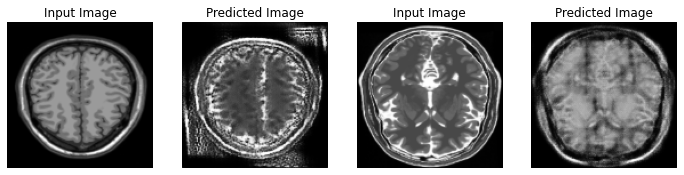

Saving checkpoint for epoch 199 at ./TrainedCGAN_Model\ckpt-199


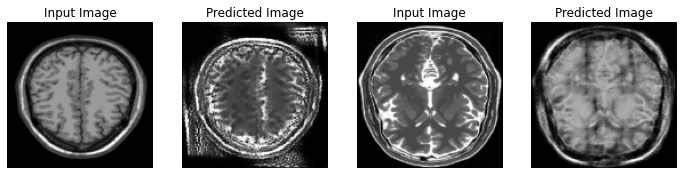

Saving checkpoint for epoch 200 at ./TrainedCGAN_Model\ckpt-200


In [ ]:
for epoch in range(1, EPOCHS+1):
    for image_x, image_y in tf.data.Dataset.zip((tr1_data, tr2_data)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_tr1, generator_f, sample_tr2)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

## Generating a GIF for visualization of Results
Notice the Quality of results we are getting.

Note: The original gif had 200 images which was very big in size and google colab crashed on embedding. We have reduced the gif to 100 images with a lossy compression to ensure the file is getting embedded for image visualization

In [ ]:
anim_file = 'cyclegan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


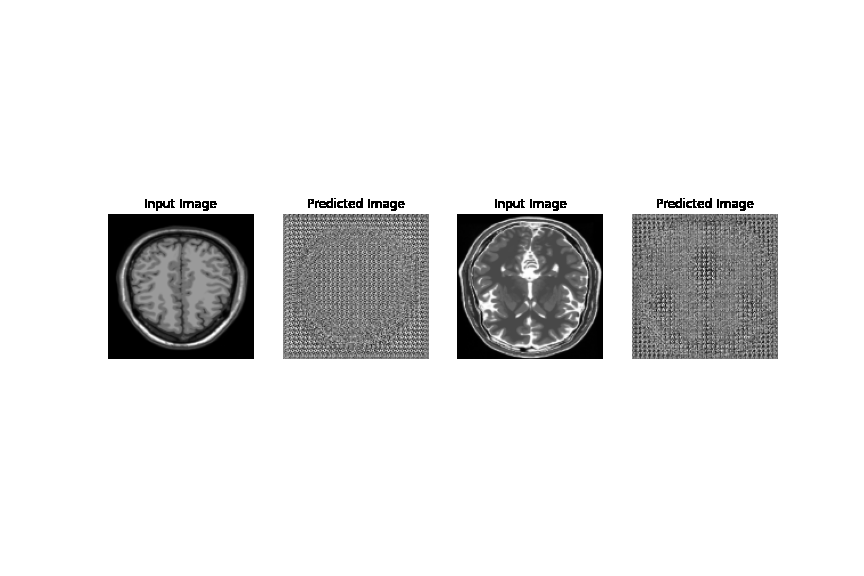

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)